In [32]:
import tensorflow as tf
from tensorflow import keras

import xarray as xr
import gcsfs
from glob import glob
from tqdm import tqdm
from dask.diagnostics import ProgressBar, Profiler
import dask
import os
import shutil
import numpy as np
from dask.distributed import Client, LocalCluster
from matplotlib import pyplot as plt
%matplotlib inline
from IPython.display import clear_output

from IPython.display import SVG
from keras.utils.vis_utils import model_to_dot
from keras.utils.vis_utils import plot_model


In [33]:
ddir = '/swot/SUM03/tmp/CESM/'

In [34]:
from keras.models import load_model


In [35]:
feature_cols = ['X', 'Y', 'Z',
                'X_e','X_w','X_n','X_s','X_ne','X_se','X_nw','X_sw',
                'Y_e','Y_w','Y_n','Y_s','Y_ne','Y_se','Y_nw','Y_sw',
                'Z_e','Z_w','Z_n','Z_s','Z_ne','Z_se','Z_nw','Z_sw',
                'TAUX','TAUY','SST','SSH',
                'SSH_e','SSH_w','SSH_n','SSH_s','SSH_ne','SSH_se','SSH_nw','SSH_sw']
model = keras.Sequential([
    keras.layers.Dense(40, activation=tf.nn.relu,
                       input_shape=(len(feature_cols),),
                       name='hidden_layer_1',),
    keras.layers.Dense(20, activation=tf.nn.relu, 
                       name='hidden_layer_2'),
    keras.layers.Dense(10, activation=tf.nn.relu, 
                       name='hidden_layer_3'),
    keras.layers.Dense(2, name='output_layer',)
])

# Define your optimizer asdf
#optimizer = tf.train.AdamOptimizer()
model.compile(loss='mse',
            optimizer='adam',
            metrics=['mae', 'mse','accuracy'])

# show a summary of the data
model.summary()



_________________________________________________________________
Layer (type)                 Output Shape              Param #   
hidden_layer_1 (Dense)       (None, 40)                1600      
_________________________________________________________________
hidden_layer_2 (Dense)       (None, 20)                820       
_________________________________________________________________
hidden_layer_3 (Dense)       (None, 10)                210       
_________________________________________________________________
output_layer (Dense)         (None, 2)                 22        
Total params: 2,652
Trainable params: 2,652
Non-trainable params: 0
_________________________________________________________________


In [36]:
model.load_weights('./model_checkpoints/weights_batch1200_3layer_402010_750d')

In [37]:
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
hidden_layer_1 (Dense)       (None, 40)                1600      
_________________________________________________________________
hidden_layer_2 (Dense)       (None, 20)                820       
_________________________________________________________________
hidden_layer_3 (Dense)       (None, 10)                210       
_________________________________________________________________
output_layer (Dense)         (None, 2)                 22        
Total params: 2,652
Trainable params: 2,652
Non-trainable params: 0
_________________________________________________________________


In [38]:
def threeD_coords(lon,lat):
    X = np.sin(np.radians(lat))
    Y = np.sin(np.radians(lon))*np.cos(np.radians(lat))
    Z = -np.cos(np.radians(lon))*np.cos(np.radians(lat))
    return (X,Y,Z)

def extract_vars_for_test(ds):
    shift_vars = ['SSH','XU','YU']
    coord_vars = ['XU','YU']

    shifts = {'_e': dict(nlon=-1),
              '_w': dict(nlon=1),
             '_n': dict(nlat=-1),
             '_s': dict(nlat=1),
             '_ne': dict(nlon=-1,nlat=-1),
             '_nw': dict(nlon=1,nlat=-1),
             '_se': dict(nlon=-1,nlat=1),
             '_sw': dict(nlon=1,nlat=1),}

    for suf, shift in shifts.items():
        for var in shift_vars:
            ds[var + suf] = ds[var].shift(**shift)
            
    suffixes = ['','_e','_w','_n','_s','_ne','_nw','_se','_sw']
    for suf in suffixes:
        ds['X'+suf],ds['Y'+suf],ds['Z'+suf], = threeD_coords(ds['XU'+suf],ds['YU'+suf])
    return ds

def ds_to_eval_df(ds):
    targets=['U','V']
    feature_cols = ['X', 'Y', 'Z',
                'X_e','X_w','X_n','X_s','X_ne','X_se','X_nw','X_sw',
                'Y_e','Y_w','Y_n','Y_s','Y_ne','Y_se','Y_nw','Y_sw',
                'Z_e','Z_w','Z_n','Z_s','Z_ne','Z_se','Z_nw','Z_sw',
                'TAUX','TAUY','SST','SSH',
                'SSH_e','SSH_w','SSH_n','SSH_s','SSH_ne','SSH_se','SSH_nw','SSH_sw']


    df = ds.to_dataframe().dropna().reset_index(drop=True)
    X = df.loc[:, feature_cols]
    y = df.loc[:, targets]
    

    return (X,y)

def ds_to_test_df(ds):
    feature_cols = ['X', 'Y', 'Z',
                'X_e','X_w','X_n','X_s','X_ne','X_se','X_nw','X_sw',
                'Y_e','Y_w','Y_n','Y_s','Y_ne','Y_se','Y_nw','Y_sw',
                'Z_e','Z_w','Z_n','Z_s','Z_ne','Z_se','Z_nw','Z_sw',
                'TAUX','TAUY','SST','SSH',
                'SSH_e','SSH_w','SSH_n','SSH_s','SSH_ne','SSH_se','SSH_nw','SSH_sw']


    df = ds.to_dataframe().dropna().reset_index(drop=True)
    X = df.loc[:, feature_cols]
    

    return X

In [39]:
ds=xr.open_zarr(ddir+'hybrid_v5_rel04_BC5_ne120_t12_pop62', auto_chunk=False).chunk({'time': 1})
ds=ds.rename({'U1_1':'U', 'V1_1':'V', 'TAUX_2':'TAUX', 'TAUY_2':'TAUY', 'SSH_2':'SSH', 'ULONG':'XU', 'ULAT':'YU'})
ds_test = ds.isel(time=slice(1824,2189))

/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/xarray/coding/times.py:132: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using dummy cftime.datetime objects instead, reason: dates out of range
  enable_cftimeindex)
/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/xarray/coding/variables.py:69: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using dummy cftime.datetime objects instead, reason: dates out of range
  return self.func(self.array)


In [45]:
ds_snap = ds_test.isel(time=176)

In [90]:
ds_snap

<xarray.Dataset>
Dimensions:  (nlat: 2400, nlon: 3600)
Dimensions without coordinates: nlat, nlon
Data variables:
    SST      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    SSH      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    TAUX     (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    TAUY     (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    XU       (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    YU       (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    U        (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    V        (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    DXT      (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    DYT      (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 360

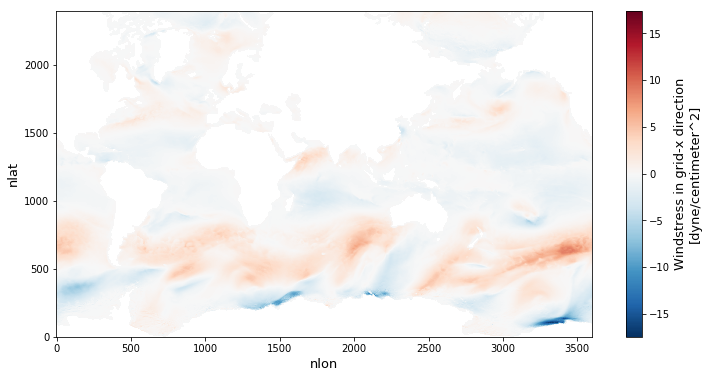

In [93]:
ds_snap.TAUX.plot()

In [42]:
def geostrophic_vel(ds):

    d_eta_dx = 0.5*(ds.SSH_e - ds.SSH_w)/ds.DXT
    d_eta_dy = 0.5*(ds.SSH_n - ds.SSH_s)/ds.DYT

    Om = 7.2921e-5
    g = 9.81e2
    f = 2 * Om * np.sin(np.deg2rad(ds.YU))
    u_g = - g * d_eta_dy * f**-1
    v_g = g * d_eta_dx * f**-1
    return u_g.values, v_g.values

def ekman_vel(ds):
    rho_a = 1.25
    rho_w = 1027
    C_D = 2.6e-3
    om = 7.2921e-5
    f = 2 * om * np.sin(np.deg2rad(ds.YU.values))
    Az = 1.0e-1  
    f_NH = np.ma.masked_array(f, ~(f>0))
    f_SH = np.ma.masked_array(f, ~(f<0))
    tau_x = ds.TAUX.values
    tau_y = ds.TAUY.values
    u_e_N = (tau_x+tau_y)/(np.sqrt(2*Az*rho_w**2) * np.sqrt(np.abs(f_NH)))
    v_e_N = (-tau_x+tau_y)/(np.sqrt(2*Az*rho_w**2) * np.sqrt(np.abs(f_NH))) 
    u_e_S = (tau_x-tau_y)/(np.sqrt(2*Az*rho_w**2) * np.sqrt(np.abs(f_SH)))
    v_e_S = (tau_x+tau_y)/(np.sqrt(2*Az*rho_w**2) * np.sqrt(np.abs(f_SH)))
    
    u_e = np.ma.array(u_e_N.filled(0)+u_e_S.filled(0), mask=u_e_N.mask * u_e_S.mask)
    v_e = np.ma.array(v_e_N.filled(0)+v_e_S.filled(0), mask=v_e_N.mask * v_e_S.mask)
    
    return u_e, v_e 


def nn_vel(ds, model):
    pred = model.predict(ds_to_test_df(ds))
    mask_tot = ~(np.isnan(ds.SSH.values) | np.isnan(ds.SSH_e.values) | np.isnan(ds.SSH_w.values) |
                 np.isnan(ds.SSH_n.values) | np.isnan(ds.SSH_s.values)| np.isnan(ds.SSH_ne.values) |
                 np.isnan(ds.SSH_nw.values)| np.isnan(ds.SSH_se.values)| np.isnan(ds.SSH_sw.values) |
                 np.isnan(ds.U.values) | np.isnan(ds.V.values) | np.isnan(ds.SST.values) | 
                 np.isnan(ds.TAUX.values) | np.isnan(ds.TAUY.values) )
    
    u_pred_flat = pred[:,0]
    v_pred_flat = pred[:,1]
    assert mask_tot.sum() == len(u_pred_flat)
    assert mask_tot.sum() == len(v_pred_flat)    
    u_true = ds.U.values
    v_true = ds.V.values
    u_nn = np.full_like(u_true, np.nan)
    u_nn[mask_tot] = u_pred_flat
    v_nn = np.full_like(u_true, np.nan)
    v_nn[mask_tot] = v_pred_flat    
    mask_lat = ((ds.YU.values>5)|(ds.YU.values<-5))
    mask_geo = (mask_tot&mask_lat)
    return mask_tot, mask_lat, mask_geo, u_true, v_true, u_nn, v_nn


def masked_vel(u, mask):
    u_masked = np.ma.masked_array(u, ~mask)
    return u_masked

def get_latlon(ds):
    XU = ds.XU.values
    YU = ds.YU.values
    return XU, YU

In [14]:
from IPython.display import clear_output

In [48]:
vars_wanted = ['SST','SSH', 'TAUX','TAUY','XU', 'YU','U','V','DXT','DYT']
it = 176
times = pd.date_range('1951-01-01', periods=len(ds_test.time)+1)
ds_snap = extract_vars_for_test(ds_test.isel(time=it).reset_coords()[vars_wanted])
vels = {}
%time vels['mask_tot'], vels['mask_lat'], vels['mask_geo'], vels['u_t_um'], vels['v_t_um'], vels['u_n_um'], vels['v_n_um'] = nn_vel(ds_snap, model)
%time vels['u_g_um'], vels['v_g_um'] = geostrophic_vel(ds_snap)
%time vels['u_e_um'], vels['v_e_um']= ekman_vel(ds_snap)

CPU times: user 1min 38s, sys: 43.6 s, total: 2min 22s
Wall time: 1min 46s


/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/dask/core.py:137: RuntimeWarning: divide by zero encountered in reciprocal
  return func(*args2)


CPU times: user 1.29 s, sys: 1.13 s, total: 2.42 s
Wall time: 1.75 s
CPU times: user 1.5 s, sys: 1.36 s, total: 2.86 s
Wall time: 2.85 s


In [107]:
np.sqrt(10)

3.1622776601683795

In [158]:
vels['u_ge_um'] = vels['u_g_um']+np.sqrt(10)*vels['u_e_um']
vels['v_ge_um'] = vels['v_g_um']+np.sqrt(10)*vels['v_e_um']

vels['u_t'] = masked_vel(vels['u_t_um'],vels['mask_geo'])
vels['v_t'] = masked_vel(vels['v_t_um'],vels['mask_geo'])
vels['u_ge'] = masked_vel(vels['u_ge_um'],vels['mask_geo'])
vels['v_ge'] = masked_vel(vels['v_ge_um'],vels['mask_geo'])
vels['u_g'] = masked_vel(vels['u_g_um'],vels['mask_geo'])
vels['v_g'] = masked_vel(vels['v_g_um'],vels['mask_geo'])
vels['u_n'] = masked_vel(vels['u_n_um'],vels['mask_geo'])
vels['v_n'] = masked_vel(vels['v_n_um'],vels['mask_geo'])

In [159]:
plt.rcParams.update({'font.size': 14
    , 'legend.markerscale': 1., 'axes.titlesize': 16, 'axes.labelsize' : 13,
      'legend.fontsize' : 13,'legend.handlelength': 3})

plt.rc('xtick', labelsize=10) 
plt.rc('ytick', labelsize=10)

lw=2
aph=.2

plt.rcParams['figure.figsize'] = (12.,6.)

In [160]:
errs = {}
#errs['mae_u_n'] = np.nanmean((np.abs(vels['u_n_um']-vels['u_t_um'])))
#errs['mae_v_n'] = np.nanmean((np.abs(vels['v_n_um']-vels['v_t_um'])))
#errs['rmse_u_n'] = np.sqrt(np.nanmean((vels['u_n_um']-vels['u_t_um'])**2))
#errs['rmse_v_n'] = np.sqrt(np.nanmean((vels['v_n_um']-vels['v_t_um'])**2))
#errs['bias_u_n'] = np.nanmean(vels['u_n_um']) - np.nanmean(vels['u_t_um'])
#errs['bias_v_n'] = np.nanmean(vels['v_n_um']) - np.nanmean(vels['v_t_um'])

errs['mae_u_n'] = np.nanmean((np.abs(vels['u_n']-vels['u_t'])))
errs['mae_v_n'] = np.nanmean((np.abs(vels['v_n']-vels['v_t'])))
errs['rmse_u_n'] = np.sqrt(np.nanmean((vels['u_n']-vels['u_t'])**2))
errs['rmse_v_n'] = np.sqrt(np.nanmean((vels['v_n']-vels['v_t'])**2))
errs['bias_u_n'] = np.nanmean(vels['u_n']) - np.nanmean(vels['u_t'])
errs['bias_v_n'] = np.nanmean(vels['v_n']) - np.nanmean(vels['v_t'])


errs['mae_u_ge'] = np.nanmean((np.abs(vels['u_ge']-vels['u_t'])))
errs['mae_v_ge'] = np.nanmean((np.abs(vels['v_ge']-vels['v_t'])))
errs['rmse_u_ge'] = np.sqrt(np.nanmean((vels['u_ge']-vels['u_t'])**2))
errs['rmse_v_ge'] = np.sqrt(np.nanmean((vels['v_ge']-vels['v_t'])**2))
errs['bias_u_ge'] = np.nanmean(vels['u_g']) - np.nanmean(vels['u_t'])
errs['bias_v_ge'] = np.nanmean(vels['v_g']) - np.nanmean(vels['v_t'])

errs['mae_u_g'] = np.nanmean((np.abs(vels['u_g']-vels['u_t'])))
errs['mae_v_g'] = np.nanmean((np.abs(vels['v_g']-vels['v_t'])))
errs['rmse_u_g'] = np.sqrt(np.nanmean((vels['u_g']-vels['u_t'])**2))
errs['rmse_v_g'] = np.sqrt(np.nanmean((vels['v_g']-vels['v_t'])**2))
errs['bias_u_g'] = np.nanmean(vels['u_g']) - np.nanmean(vels['u_t'])
errs['bias_v_g'] = np.nanmean(vels['v_g']) - np.nanmean(vels['v_t'])



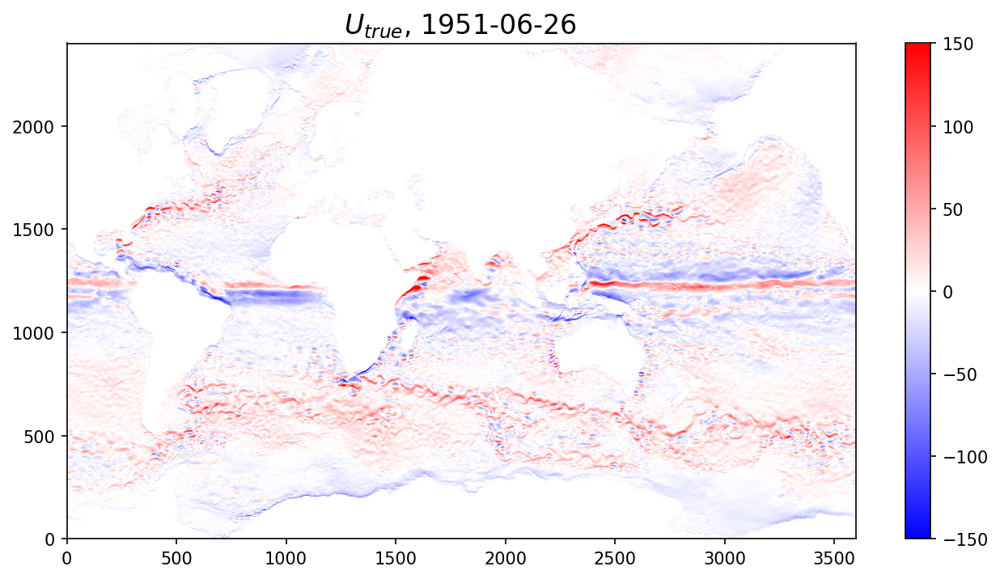

In [161]:
fig = plt.figure(figsize=(9,5),dpi=150)
plt.pcolormesh(vels['u_t_um'],vmin=-150,vmax=150,cmap='bwr',rasterized=True );
plt.colorbar()
plt.title(r'$U_{true}$, 1951-06-26 ');
plt.tight_layout()
fig.savefig('Figs_NN/U_true_globe_176.png')
fig.savefig('Figs_NN/U_true_globe_176.pdf', dpi=150)

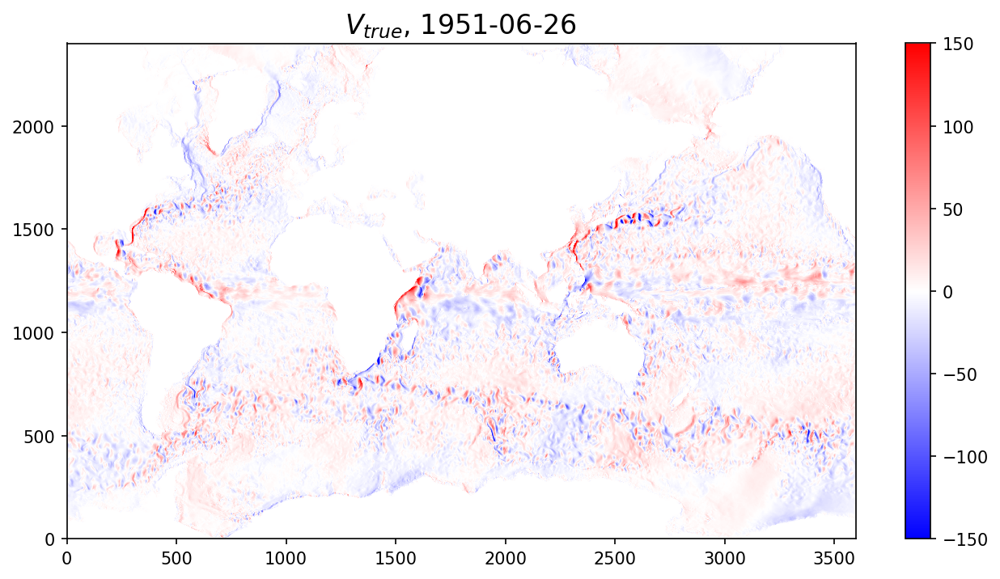

In [162]:
fig = plt.figure(figsize=(9,5),dpi=150)
plt.pcolormesh(vels['v_t_um'],vmin=-150,vmax=150,cmap='bwr',rasterized=True );
plt.colorbar()
plt.title(r'$V_{true}$, 1951-06-26 ');
plt.tight_layout()
fig.savefig('Figs_NN/V_true_globe_176.png')
fig.savefig('Figs_NN/V_true_globe_176.pdf', dpi=150)

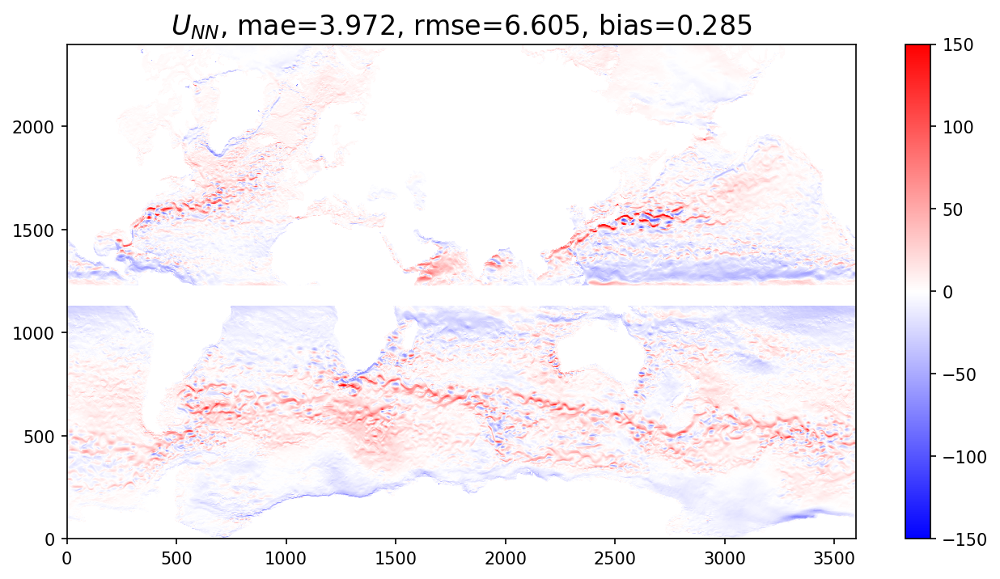

In [169]:
fig = plt.figure(figsize=(9,5),dpi=150)
plt.pcolormesh(vels['u_n'],vmin=-150,vmax=150,cmap='bwr',rasterized=True );
plt.colorbar()
plt.title(r'$U_{NN}$, mae=%1.3f, rmse=%1.3f, bias=%1.3f'%(errs['mae_u_n'],errs['rmse_u_n'],errs['bias_u_n']) );
plt.tight_layout()
fig.savefig('Figs_NN/U_NN_globe_176.png')
fig.savefig('Figs_NN/U_NN_globe_176.pdf', dpi=150)


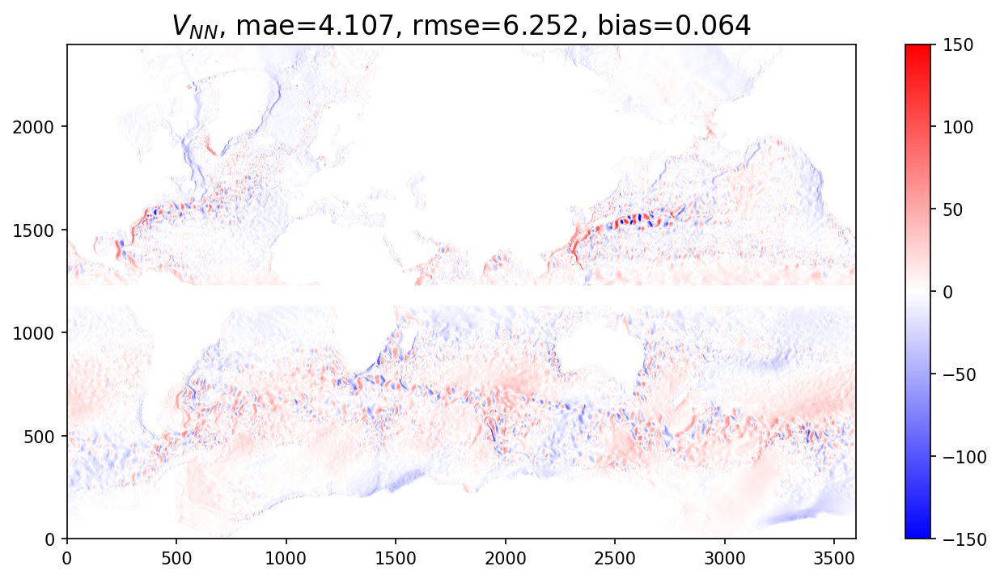

In [170]:
fig = plt.figure(figsize=(9,5),dpi=150)
plt.pcolormesh(vels['v_n'],vmin=-150,vmax=150,cmap='bwr',rasterized=True );
plt.colorbar()
plt.title(r'$V_{NN}$, mae=%1.3f, rmse=%1.3f, bias=%1.3f'%(errs['mae_v_n'],errs['rmse_v_n'],errs['bias_v_n']) );
plt.tight_layout()
fig.savefig('Figs_NN/V_NN_globe_176.png')
fig.savefig('Figs_NN/V_NN_globe_176.pdf', dpi=150)


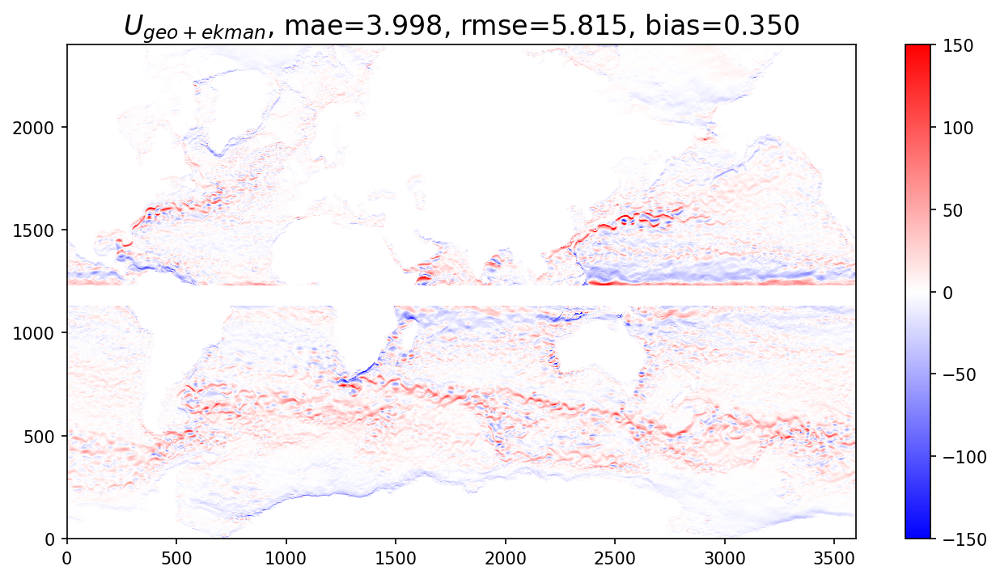

In [165]:
fig = plt.figure(figsize=(9,5),dpi=150)
plt.pcolormesh(vels['u_ge'],vmin=-150,vmax=150,cmap='bwr',rasterized=True );
plt.colorbar()
plt.title(r'$U_{geo+ekman}$, mae=%1.3f, rmse=%1.3f, bias=%1.3f'%(errs['mae_u_ge'],errs['rmse_u_ge'],errs['bias_u_ge']) );
plt.tight_layout()
fig.savefig('Figs_NN/U_ge_globe_176.png')
fig.savefig('Figs_NN/U_ge_globe_176.pdf', dpi=150)


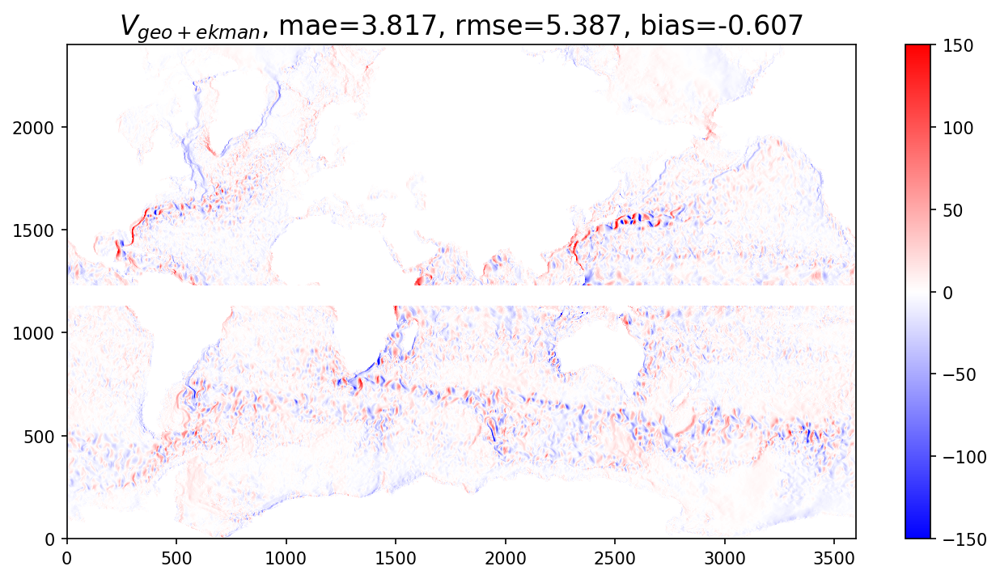

In [166]:
fig = plt.figure(figsize=(9,5),dpi=150)
plt.pcolormesh(vels['v_ge'],vmin=-150,vmax=150,cmap='bwr',rasterized=True );
plt.colorbar()
plt.title(r'$V_{geo+ekman}$, mae=%1.3f, rmse=%1.3f, bias=%1.3f'%(errs['mae_v_ge'],errs['rmse_v_ge'],errs['bias_v_ge']) );
plt.tight_layout()
fig.savefig('Figs_NN/V_ge_globe_176.png')
fig.savefig('Figs_NN/V_ge_globe_176.pdf', dpi=150)


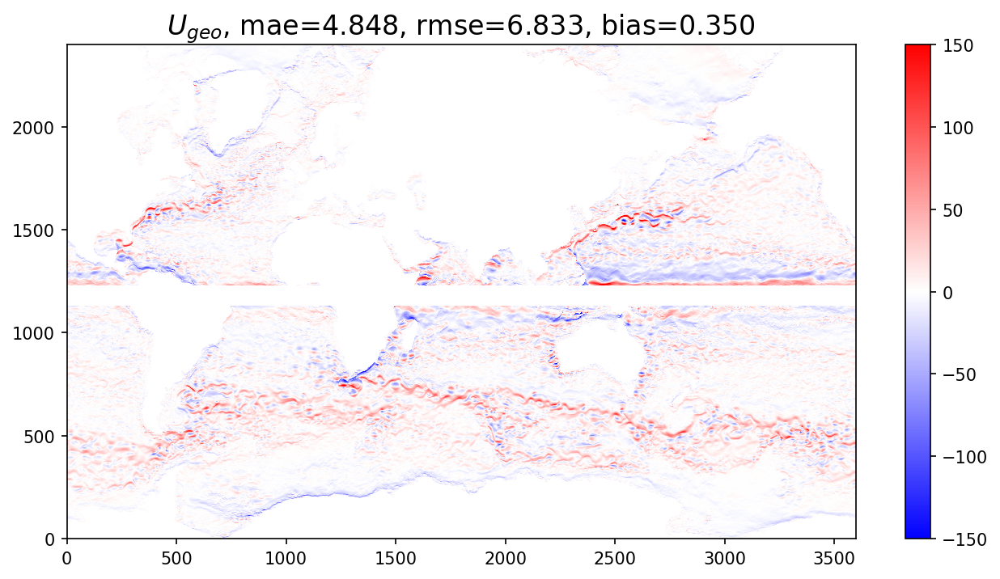

In [167]:
fig = plt.figure(figsize=(9,5),dpi=150)
plt.pcolormesh(vels['u_g'],vmin=-150,vmax=150,cmap='bwr',rasterized=True );
plt.colorbar()
plt.title(r'$U_{geo}$, mae=%1.3f, rmse=%1.3f, bias=%1.3f'%(errs['mae_u_g'],errs['rmse_u_g'],errs['bias_u_g']) );
plt.tight_layout()
fig.savefig('Figs_NN/U_g_globe_176.png')
fig.savefig('Figs_NN/U_g_globe_176.pdf', dpi=150)


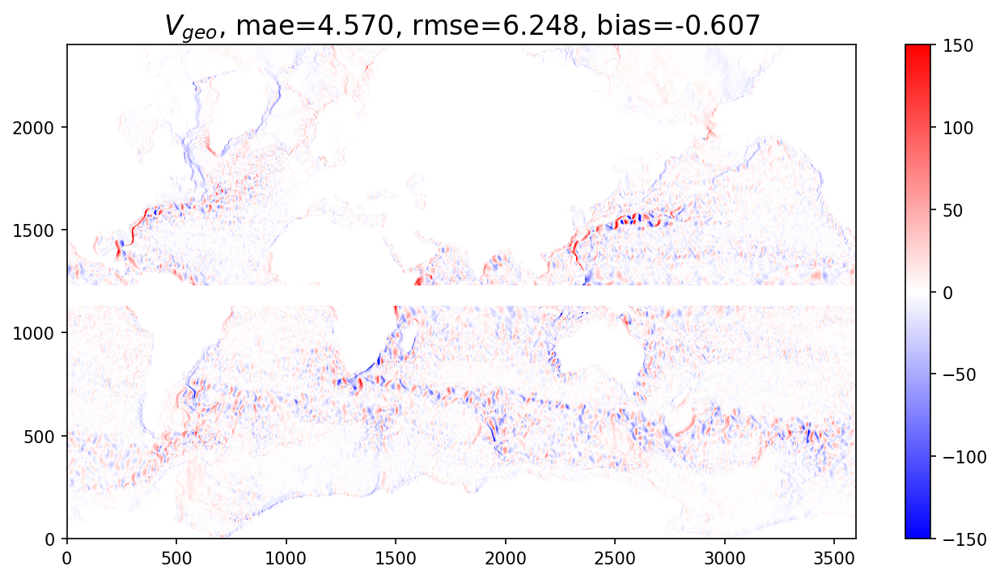

In [168]:
fig = plt.figure(figsize=(9,5),dpi=150)
plt.pcolormesh(vels['v_g'],vmin=-150,vmax=150,cmap='bwr',rasterized=True );
plt.colorbar()
plt.title(r'$V_{geo}$, mae=%1.3f, rmse=%1.3f, bias=%1.3f'%(errs['mae_v_g'],errs['rmse_v_g'],errs['bias_v_g']) );
plt.tight_layout()
fig.savefig('Figs_NN/V_g_globe_176.png')
fig.savefig('Figs_NN/V_g_globe_176.pdf', dpi=150)


In [20]:
ds_snap = extract_vars_for_test(ds_test.isel(time=it).reset_coords()[vars_wanted])

In [22]:
%time pred = model.predict(ds_to_test_df(ds_snap))
u_pred_flat = pred[:,0]
v_pred_flat = pred[:,1]

In [27]:
X = ds_to_test_df(ds_snap)
len(X)

5324508

In [28]:
mask_tot = ~(np.isnan(ds_snap.SSH.values) | np.isnan(ds_snap.SSH_e.values) | np.isnan(ds_snap.SSH_w.values) |
             np.isnan(ds_snap.SSH_n.values) | np.isnan(ds_snap.SSH_s.values)| np.isnan(ds_snap.SSH_ne.values) |
             np.isnan(ds_snap.SSH_nw.values)| np.isnan(ds_snap.SSH_se.values)| np.isnan(ds_snap.SSH_sw.values) |
             np.isnan(ds_snap.U.values) | np.isnan(ds_snap.V.values) | np.isnan(ds_snap.SST.values) | 
             np.isnan(ds_snap.TAUX.values) | np.isnan(ds_snap.TAUY.values) )

In [29]:
print(mask_tot.sum(), len(u_pred_flat))

5324508 5324508


In [21]:
vels['mask_tot'], vels['mask_lat'], vels['mask_geo'], vels['u_t_um'], vels['v_t_um'], vels['u_n_um'], vels['v_n_um'] = nn_vel(ds_snap, model)

AssertionError: 

In [15]:
import pandas as pd

In [16]:
outdir = '/swot/SUM02/as4479/POP_nn_predictions/'

In [31]:
for it in range(len(ds_test.time)):
    clear_output(wait=True)

    vars_wanted = ['SST','SSH', 'TAUX','TAUY','XU', 'YU','U','V','DXT','DYT']

    times = pd.date_range('1951-01-01', periods=len(ds_test.time)+1)
    ds_snap = extract_vars_for_test(ds_test.isel(time=it).reset_coords()[vars_wanted])
    vels = {}
    %time vels['mask_tot'], vels['mask_lat'], vels['mask_geo'], vels['u_t_um'], vels['v_t_um'], vels['u_n_um'], vels['v_n_um'] = nn_vel(ds_snap, model)
    %time vels['u_g_um'], vels['v_g_um'] = geostrophic_vel(ds_snap)
    %time vels['u_e_um'], vels['v_e_um']= ekman_vel(ds_snap)

    varlist = ['u','v']
    suffix1 = ['_g','_e','_n','_t']
    suffix2 = '_um'
    
    for var in varlist:
        for suf in suffix1:
            vels[var+suf] = masked_vel(vels[var+suf+suffix2],vels['mask_geo'])

    vels['u_ge'] = vels['u_g'] + vels['u_e']
    vels['v_ge'] = vels['v_g'] + vels['v_e']
    vels['XU'],vels['YU'] = get_latlon(ds_snap)

    ds_new = xr.Dataset()
    for key in vels.keys():
        ds_new[key] = xr.DataArray(vels[key][np.newaxis,:],
                                    dims=['time','nlat', 'nlon'], 
                                    coords={'time':times[it:it+1], 'nlon':ds_snap.nlon, 'nlat': ds_snap.nlat} )
    ds_new.to_netcdf(outdir+'POP_global_1200batch_3layer402010nn_pred_%05d.nc'%it)
    print('Time=%05d'%it)

CPU times: user 1min 29s, sys: 39.6 s, total: 2min 8s
Wall time: 1min 39s


/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/dask/core.py:137: RuntimeWarning: divide by zero encountered in reciprocal
  return func(*args2)


CPU times: user 1.27 s, sys: 1.32 s, total: 2.59 s
Wall time: 1.87 s
CPU times: user 1.49 s, sys: 1.54 s, total: 3.03 s
Wall time: 3.02 s
Time=00364


In [125]:
def extract_vars_for_rossby(ds):
    shift_vars = ['U','V']

    shifts = {'_e': dict(nlon=-1),
              '_w': dict(nlon=1),
             '_n': dict(nlat=-1),
             '_s': dict(nlat=1),
             }

    for suf, shift in shifts.items():
        for var in shift_vars:
            ds[var + suf] = ds[var].shift(**shift)

    return ds

In [126]:
times = pd.date_range('1951-01-01', periods=len(ds_test.time)+1)
vars_wanted = ['XU', 'YU','U','V','DXT','DYT']

it = 20
ds_ross = extract_vars_for_rossby(ds_test.isel(time=it).reset_coords()[vars_wanted])

In [127]:
ds_ross

<xarray.Dataset>
Dimensions:  (nlat: 2400, nlon: 3600)
Dimensions without coordinates: nlat, nlon
Data variables:
    XU       (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    YU       (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    U        (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    V        (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    DXT      (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    DYT      (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    U_e      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    V_e      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    U_w      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    V_w      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 360

In [128]:
Om = 7.2921e-5

ds_ross['zeta'] = 0.5*(ds_ross.V_e - ds_ross.V_w)/ds_ross.DXT - 0.5*(ds_ross.U_n - ds_ross.U_s)/ds_ross.DYT
ds_ross['f'] = 2 * Om * np.sin(np.deg2rad(ds_ross.YU))

In [129]:
ds_ross['Ro'] = ds_ross.zeta/ds_ross.f

In [145]:
ds_ross

<xarray.Dataset>
Dimensions:  (nlat: 2400, nlon: 3600)
Dimensions without coordinates: nlat, nlon
Data variables:
    XU       (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    YU       (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    U        (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    V        (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    DXT      (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    DYT      (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    U_e      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    V_e      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    U_w      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    V_w      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 360

/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/dask/core.py:137: RuntimeWarning: divide by zero encountered in true_divide
  return func(*args2)
/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/dask/core.py:137: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)


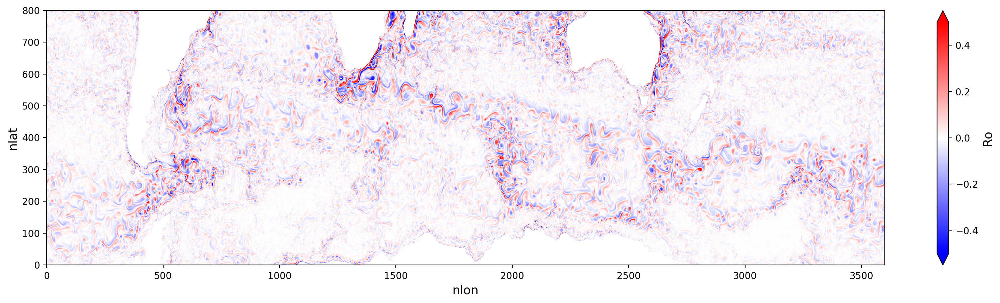

In [140]:
plt.figure(figsize=(20,5), dpi=200);

ds_ross.isel(nlat=slice(200,1000)).Ro.plot(vmin=-0.5,vmax=0.5,cmap='bwr')

/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/dask/core.py:137: RuntimeWarning: divide by zero encountered in true_divide
  return func(*args2)
/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/dask/core.py:137: RuntimeWarning: invalid value encountered in true_divide
  return func(*args2)


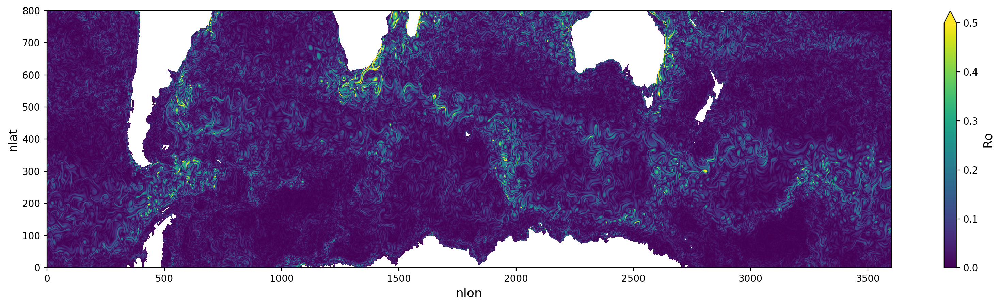

In [143]:
plt.figure(figsize=(20,5), dpi=200);

np.abs(ds_ross.isel(nlat=slice(200,1000)).Ro).plot(vmin=0,vmax=0.5,cmap='viridis')

In [147]:
for it in range(len(ds_test.time)):
    clear_output(wait=True)
    
    times = pd.date_range('1951-01-01', periods=len(ds_test.time)+1)
    vars_wanted = ['XU', 'YU','U','V','DXT','DYT']

    ds_ross = extract_vars_for_rossby(ds_test.isel(time=it).reset_coords()[vars_wanted])

    Om = 7.2921e-5

    ds_ross['zeta'] = 0.5*(ds_ross.V_e - ds_ross.V_w)/ds_ross.DXT - 0.5*(ds_ross.U_n - ds_ross.U_s)/ds_ross.DYT
    ds_ross['f'] = 2 * Om * np.sin(np.deg2rad(ds_ross.YU))
    ds_ross['Ro'] = ds_ross.zeta/ds_ross.f
    
    ds_ross.to_netcdf(outdir+'POP_global_RossbyNumber_%05d.nc'%it)
    print('Time=%05d'%it)

Time=00364


In [154]:
ds_ross

<xarray.Dataset>
Dimensions:  (nlat: 2400, nlon: 3600)
Dimensions without coordinates: nlat, nlon
Data variables:
    XU       (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    YU       (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    U        (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    V        (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    DXT      (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    DYT      (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    U_e      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    V_e      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    U_w      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    V_w      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 360

In [156]:
for it in range(len(ds_test.time)):
    clear_output(wait=True)
    
    times = pd.date_range('1951-01-01', periods=len(ds_test.time)+1)
    vars_wanted = ['XU', 'YU','U','V','DXT','DYT']

    ds_ross = extract_vars_for_rossby(ds_test.isel(time=it).reset_coords()[vars_wanted])

    Om = 7.2921e-5
    
    ross = {}
    
    ross['zeta'] = (0.5*(ds_ross.V_e - ds_ross.V_w)/ds_ross.DXT - 0.5*(ds_ross.U_n - ds_ross.U_s)/ds_ross.DYT).values
    ross['f'] = (2 * Om * np.sin(np.deg2rad(ds_ross.YU))).values
    ross['Ro'] = (ross['zeta']/ross['f'])
    ross['DXT'] = ds_ross.DXT.values
    ross['DYT'] = ds_ross.DYT.values
    ross['XU'] = ds_ross.XU.values
    ross['YU'] = ds_ross.YU.values
    ross['U'] = ds_ross.U.values
    ross['V'] = ds_ross.V.values
    
    ds_new = xr.Dataset()
    for key in ross.keys():
        ds_new[key] = xr.DataArray(ross[key][np.newaxis,:],
                                    dims=['time','nlat', 'nlon'], 
                                    coords={'time':times[it:it+1], 'nlon':ds_ross.nlon, 'nlat': ds_ross.nlat} )
    ds_new.to_netcdf(outdir+'POP_RossbyNumber_%05d.nc'%it)
    print('Time=%05d'%it)

Time=00364


In [327]:
it = 0
vars_wanted = ['SST','SSH', 'TAUX','TAUY','XU', 'YU','U','V','DXT','DYT']

times = pd.date_range('1951-01-01', periods=len(ds_test.time))

ds_snap = extract_vars_for_test(ds_test.isel(time=it).reset_coords()[vars_wanted])


vels = {}
vels['mask_tot'], vels['mask_lat'], vels['mask_geo'], vels['u_t_um'], vels['v_t_um'], vels['u_n_um'], vels['v_n_um'] = nn_vel(ds_snap)
vels['u_g_um'], vels['v_g_um'] = geostrophic_vel(ds_snap)
vels['u_e_um'], vels['v_e_um']= ekman_vel(ds_snap)

varlist = ['u','v']
suffix1 = ['_g','_e','_n','_t']

suffix2 = '_um'
for var in varlist:
    for suf in suffix1:
        vels[var+suf] = masked_vel(vels[var+suf+suffix2],vels['mask_geo'])

vels['u_ge'] = vels['u_g'] + vels['u_e']
vels['v_ge'] = vels['v_g'] + vels['v_e']
vels['XU'],vels['YU'] = get_latlon(ds_snap)

ds_new = xr.Dataset()
for key in vels.keys():
    ds_new[key] = xr.DataArray(vels[key][np.newaxis,:],
                                dims=['time','nlat', 'nlon'], 
                                coords={'time':times[it:it+1], 'nlon':ds_snap.nlon, 'nlat': ds_snap.nlat} )
ds_new.to_netcdf(outdir+'POP_global_1200batch_3layer402010nn_pred_%05d.nc'%it)

CPU times: user 1min 40s, sys: 46.5 s, total: 2min 27s
Wall time: 1min 45s


/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/dask/core.py:137: RuntimeWarning: divide by zero encountered in reciprocal
  return func(*args2)
/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/dask/core.py:137: RuntimeWarning: invalid value encountered in multiply
  return func(*args2)


In [328]:
ds_new

<xarray.Dataset>
Dimensions:   (nlat: 2400, nlon: 3600, time: 1)
Coordinates:
  * time      (time) datetime64[ns] 1951-01-01
  * nlon      (nlon) int64 0 1 2 3 4 5 6 ... 3593 3594 3595 3596 3597 3598 3599
  * nlat      (nlat) int64 0 1 2 3 4 5 6 ... 2393 2394 2395 2396 2397 2398 2399
Data variables:
    mask_tot  (time, nlat, nlon) bool False False False ... False False False
    mask_lat  (time, nlat, nlon) bool False False False ... False False False
    mask_geo  (time, nlat, nlon) bool False False False ... False False False
    u_t_um    (time, nlat, nlon) float32 nan nan nan nan nan ... nan nan nan nan
    v_t_um    (time, nlat, nlon) float32 nan nan nan nan nan ... nan nan nan nan
    u_n_um    (time, nlat, nlon) float32 nan nan nan nan nan ... nan nan nan nan
    v_n_um    (time, nlat, nlon) float32 nan nan nan nan nan ... nan nan nan nan
    u_g_um    (time, nlat, nlon) float64 nan nan nan nan nan ... nan nan nan nan
    v_g_um    (time, nlat, nlon) float64 nan nan nan nan nan

In [320]:
times[it+1:it+2]

DatetimeIndex(['1951-01-02'], dtype='datetime64[ns]', freq='D')

In [315]:
pd.date_range('1951-01-01', periods=1).shape

(1,)

In [346]:
it = 176
vars_wanted = ['SST','SSH', 'TAUX','TAUY','XU', 'YU','U','V','DXT','DYT']

times = pd.date_range('1951-01-01', periods=len(ds_test.time))

ds_snap = extract_vars_for_test(ds_test.isel(time=it).reset_coords()[vars_wanted])


vels = {}
vels['mask_tot'], vels['mask_lat'], vels['mask_geo'], vels['u_t_um'], vels['v_t_um'], vels['u_n_um'], vels['v_n_um'] = nn_vel(ds_snap)
vels['u_g_um'], vels['v_g_um'] = geostrophic_vel(ds_snap)
vels['u_e_um'], vels['v_e_um']= ekman_vel(ds_snap)

varlist = ['u','v']
suffix1 = ['_g','_e','_n','_t']
suffix2 = '_um'
for var in varlist:
    for suf in suffix1:
        vels[var+suf] = masked_vel(vels[var+suf+suffix2],vels['mask_geo'])

vels['u_ge'] = vels['u_g'] + vels['u_e']
vels['v_ge'] = vels['v_g'] + vels['v_e']
vels['XU'],vels['YU'] = get_latlon(ds_snap)

ds_new = xr.Dataset()
for key in vels.keys():
    ds_new[key] = xr.DataArray(vels[key][np.newaxis,:],
                                dims=['time','nlat', 'nlon'], 
                                coords={'time':times[it:it+1], 'nlon':ds_snap.nlon, 'nlat': ds_snap.nlat} )

ds_new.to_netcdf(outdir+'POP_global_1200batch_3layer402010nn_pred_%05d.nc'%it)

CPU times: user 1min 27s, sys: 41.4 s, total: 2min 9s
Wall time: 1min 38s


/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/dask/core.py:137: RuntimeWarning: divide by zero encountered in reciprocal
  return func(*args2)


In [347]:
ds_new

<xarray.Dataset>
Dimensions:   (nlat: 2400, nlon: 3600, time: 1)
Coordinates:
  * time      (time) datetime64[ns] 1951-06-26
  * nlon      (nlon) int64 0 1 2 3 4 5 6 ... 3593 3594 3595 3596 3597 3598 3599
  * nlat      (nlat) int64 0 1 2 3 4 5 6 ... 2393 2394 2395 2396 2397 2398 2399
Data variables:
    mask_tot  (time, nlat, nlon) bool False False False ... False False False
    mask_lat  (time, nlat, nlon) bool False False False ... False False False
    mask_geo  (time, nlat, nlon) bool False False False ... False False False
    u_t_um    (time, nlat, nlon) float32 nan nan nan nan nan ... nan nan nan nan
    v_t_um    (time, nlat, nlon) float32 nan nan nan nan nan ... nan nan nan nan
    u_n_um    (time, nlat, nlon) float32 nan nan nan nan nan ... nan nan nan nan
    v_n_um    (time, nlat, nlon) float32 nan nan nan nan nan ... nan nan nan nan
    u_g_um    (time, nlat, nlon) float64 nan nan nan nan nan ... nan nan nan nan
    v_g_um    (time, nlat, nlon) float64 nan nan nan nan nan

In [ ]:
it = 1
vars_wanted = ['SST','SSH', 'TAUX','TAUY','XU', 'YU','U','V','DXT','DYT']

times = pd.date_range('1951-01-01', periods=len(ds_test.time))

ds_snap = extract_vars_for_test(ds_test.isel(time=it).reset_coords()[vars_wanted])


vels = {}
vels['mask_tot'], vels['mask_lat'], vels['mask_geo'], vels['u_t_um'], vels['v_t_um'], vels['u_n_um'], vels['v_n_um'] = nn_vel(ds_snap)
vels['u_g_um'], vels['v_g_um'] = geostrophic_vel(ds_snap)
vels['u_e_um'], vels['v_e_um']= ekman_vel(ds_snap)

varlist = ['u','v']
suffix1 = ['_g','_e','_n','_t']
suffix2 = '_um'
for var in varlist:
    for suf in suffix1:
        vels[var+suf] = masked_vel(vels[var+suf+suffix2],vels['mask_geo'])

vels['u_ge'] = vels['u_g'] + vels['u_e']
vels['v_ge'] = vels['v_g'] + vels['v_e']
vels['XU'],vels['YU'] = get_latlon(ds_snap)

ds_new = xr.Dataset()
for key in vels.keys():
    ds_new[key] = xr.DataArray(vels[key][np.newaxis,:],
                                dims=['time','nlat', 'nlon'], 
                                coords={'time':times[it:it+1], 'nlon':ds_snap.nlon, 'nlat': ds_snap.nlat} )

ds_new.to_netcdf(outdir+'POP_global_1200batch_3layer402010nn_pred_%05d.nc'%it)

In [348]:
ds_open = xr.open_mfdataset(outdir+'*.nc')

In [349]:
mae = {}
mae['u_n-t'] = np.abs(ds_open.u_n - ds_open.u_t)
mae['v_n-t'] = np.abs(ds_open.v_n - ds_open.v_t)


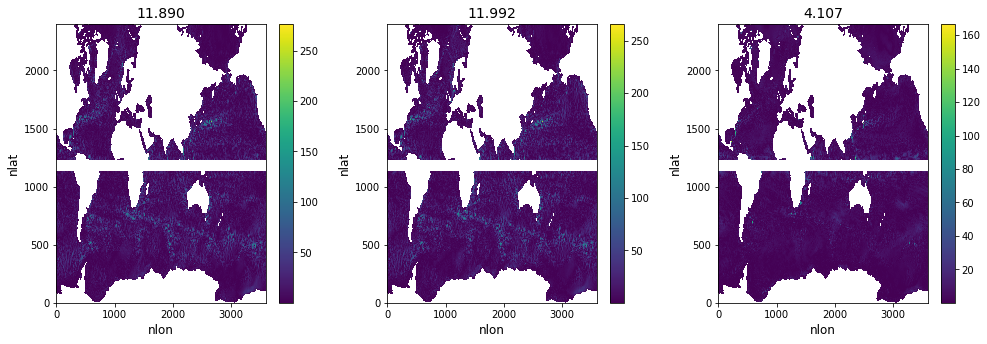

In [350]:
plt.subplot(131)
mae['v_n-t'].isel(time=0).plot()
plt.title('%1.3f'%np.nanmean(mae['v_n-t'].isel(time=0)));
plt.subplot(132)
mae['v_n-t'].isel(time=1).plot()
plt.title('%1.3f'%np.nanmean(mae['v_n-t'].isel(time=1)));
plt.subplot(133)
mae['v_n-t'].isel(time=2).plot()
plt.title('%1.3f'%np.nanmean(mae['v_n-t'].isel(time=2)));
plt.tight_layout()

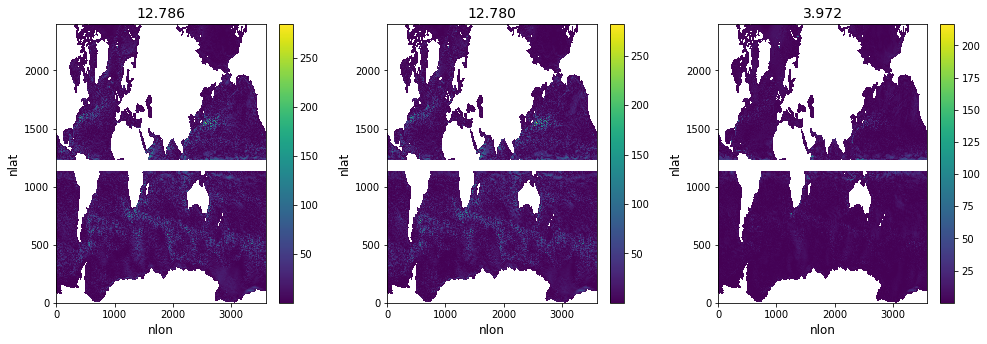

In [351]:
plt.subplot(131)
mae['u_n-t'].isel(time=0).plot()
plt.title('%1.3f'%np.nanmean(mae['u_n-t'].isel(time=0)));
plt.subplot(132)
mae['u_n-t'].isel(time=1).plot()
plt.title('%1.3f'%np.nanmean(mae['u_n-t'].isel(time=1)));
plt.subplot(133)
mae['u_n-t'].isel(time=2).plot()
plt.title('%1.3f'%np.nanmean(mae['u_n-t'].isel(time=2)));
plt.tight_layout()

In [178]:
ds_snap0 = ds_test.isel(time=0).reset_coords()

vars_wanted = ['SST','SSH', 'TAUX','TAUY','XU', 'YU','U','V','DXT','DYT']
#ds_snap1 = ds_snap0[vars_wanted]
#ds_snap1

ds_snap = extract_vars_for_test(ds_snap0[vars_wanted])
ds_snap

/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/xarray/coding/times.py:132: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using dummy cftime.datetime objects instead, reason: dates out of range
  enable_cftimeindex)
/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/xarray/coding/variables.py:69: SerializationWarning: Unable to decode time axis into full numpy.datetime64 objects, continuing using dummy cftime.datetime objects instead, reason: dates out of range
  return self.func(self.array)


<xarray.Dataset>
Dimensions:  (nlat: 2400, nlon: 3600)
Dimensions without coordinates: nlat, nlon
Data variables:
    SST      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    SSH      (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    TAUX     (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    TAUY     (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    XU       (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    YU       (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    U        (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    V        (nlat, nlon) float32 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    DXT      (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 3600)>
    DYT      (nlat, nlon) float64 dask.array<shape=(2400, 3600), chunksize=(2400, 360

In [170]:
ds_snap00 = ds_test.isel(time=0)

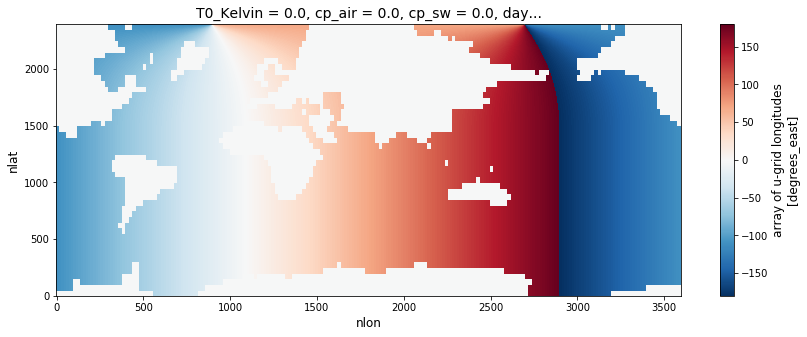

In [173]:
ds_snap00.XU.plot()

In [10]:
X,y = ds_to_eval_df(ds_snap)

In [11]:
%time model_eval = model.evaluate(X,y)
model_eval


5324509/5324509 [==============================] - 119s 22us/step
CPU times: user 3min 9s, sys: 35.5 s, total: 3min 44s
Wall time: 2min


[70.62113152602396, 4.714874189167986, 70.62113152602396, 0.8334383508413752]

In [12]:
%time pred = model.predict(X)
pred.shape

CPU times: user 1min 18s, sys: 14 s, total: 1min 32s
Wall time: 51.3 s


(5324509, 2)

CPU times: user 1min, sys: 9.78 s, total: 1min 10s
Wall time: 41.1 s


(5324509, 2)

In [13]:
mask_tot = ~(np.isnan(ds_snap.SSH.values) | np.isnan(ds_snap.SSH_e.values)| np.isnan(ds_snap.SSH_w.values)|np.isnan(ds_snap.SSH_n.values)|
            np.isnan(ds_snap.SSH_s.values)|np.isnan(ds_snap.SSH_ne.values)|np.isnan(ds_snap.SSH_nw.values)|np.isnan(ds_snap.SSH_se.values)|
            np.isnan(ds_snap.SSH_sw.values)
           )
mask_tot.sum()


5324509

In [14]:
u_pred_flat = pred[:,0]
v_pred_flat = pred[:,1]

assert mask_tot.sum() == len(u_pred_flat)
assert mask_tot.sum() == len(v_pred_flat)


In [15]:
u_true = ds_snap.U.values
v_true = ds_snap.V.values

In [16]:
u_nn = np.full_like(u_true, np.nan)
u_nn[mask_tot] = u_pred_flat
v_nn = np.full_like(u_true, np.nan)
v_nn[mask_tot] = v_pred_flat


In [17]:
def geostrophic_vel(ds):

    d_eta_dx = 0.5*(ds_snap.SSH_e - ds_snap.SSH_w)/ds_snap.DXT
    d_eta_dy = 0.5*(ds_snap.SSH_n - ds_snap.SSH_s)/ds_snap.DYT

    Om = 7.2921e-5
    g = 9.81e2
    f = 2 * Om * np.sin(np.deg2rad(ds.YU))
    
    u_g = - g * d_eta_dy * f**-1
    v_g = g * d_eta_dx *f**-1
    
    return u_g.values, v_g.values

In [18]:
u_g, v_g = geostrophic_vel(ds_snap)

/home/as4479/new_miniconda/miniconda/envs/pangeo/lib/python3.6/site-packages/dask/core.py:137: RuntimeWarning: divide by zero encountered in reciprocal
  return func(*args2)


In [19]:
mask_lat = ((ds_snap.YU.values>5)|(ds_snap.YU.values<-5))
mask_geo = (mask_tot&mask_lat)


u_geo = np.ma.masked_array(u_g, ~mask_geo)
u_tr = np.ma.masked_array(u_true, ~mask_geo)
u_N = np.ma.masked_array(u_nn, ~mask_geo)

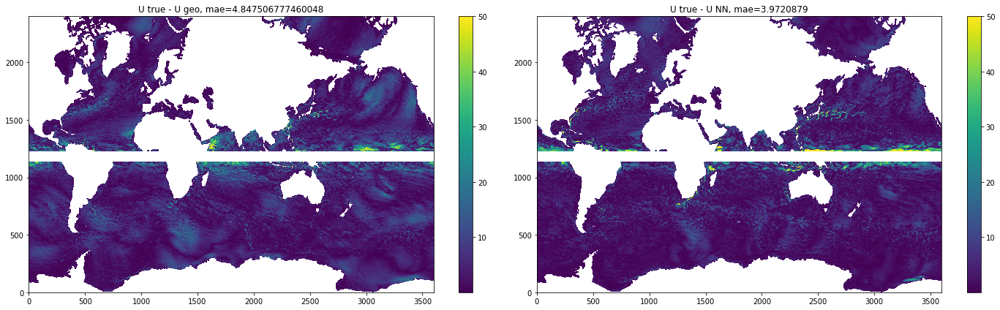

In [22]:
fig = plt.figure(figsize=(20,6))
plt.subplot(121)
plt.pcolormesh(np.abs(u_tr-u_geo), vmax=50, cmap='viridis');
plt.title('U true - U geo, mae=%s' %np.nanmean(np.abs(u_tr-u_geo)))
plt.colorbar()

plt.subplot(122)
plt.pcolormesh(np.abs(u_tr-u_N), vmax=50, cmap='viridis');
plt.title('U true - U NN, mae=%s' %np.nanmean(np.abs(u_tr-u_N)))
plt.colorbar()

plt.tight_layout()


In [23]:
MAE_geo = np.nanmean(np.abs(u_tr-u_geo))
MAE_NN = np.nanmean(np.abs(u_tr-u_N))
bias_geo = np.nanmean(np.abs(u_tr)) - np.nanmean(np.abs(u_geo))
bias_NN = np.nanmean(np.abs(u_tr)) - np.nanmean(np.abs(u_N))


In [24]:
print('Bias geos=',bias_geo,'Bias NN=', bias_NN)

Bias geos= 1.7282153446191515 Bias NN= 0.31364346


In [50]:
def get_f(ds):
    om = 7.2921e-5
    f = 2 * om * np.sin(np.deg2rad(ds.YU.values))
    return f

In [51]:
f = get_f(ds_snap)

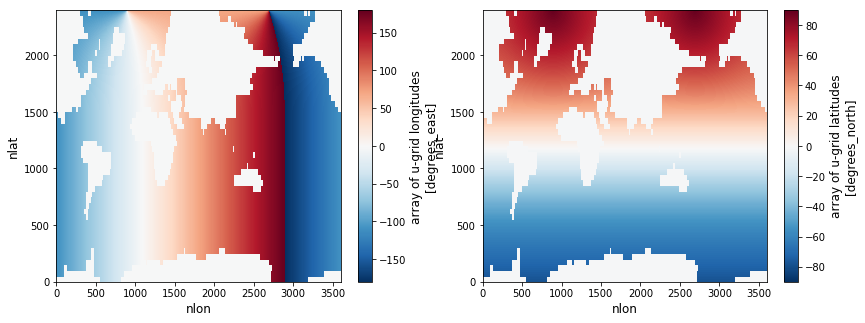

In [134]:
plt.subplot(121)
ds_snap.XU.plot()
plt.subplot(122)
ds_snap.YU.plot()


In [174]:
XU = ds_snap.XU.values
YU = ds_snap.YU.values
#lon,lat = np.meshgrid(XU,YU, sparse=True, copy=True)

In [ ]:
XU_masked = np.ma.masked

In [179]:
import xarray as xr
from modify_pop_for_xgcm import relabel_pop_dims

ds_test_new = relabel_pop_dims(ds_test)

# now you can use xgcm
import xgcm
grid = xgcm.Grid(ds)

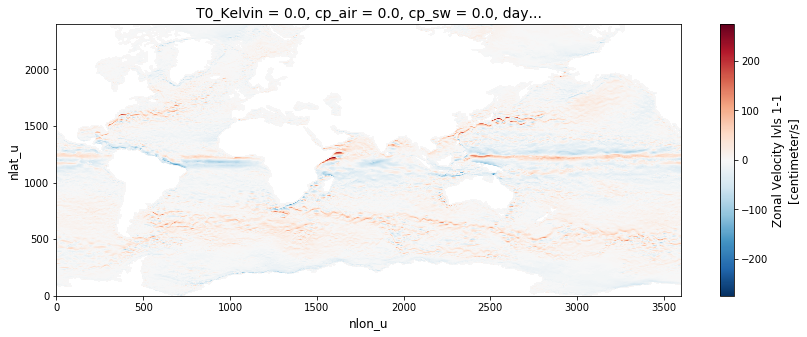

In [185]:
ds_test_new.isel(time=0).U1_1.plot()

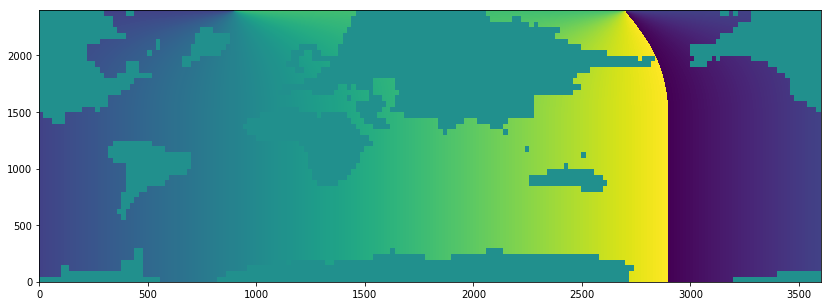

In [167]:
plt.pcolormesh(XU)

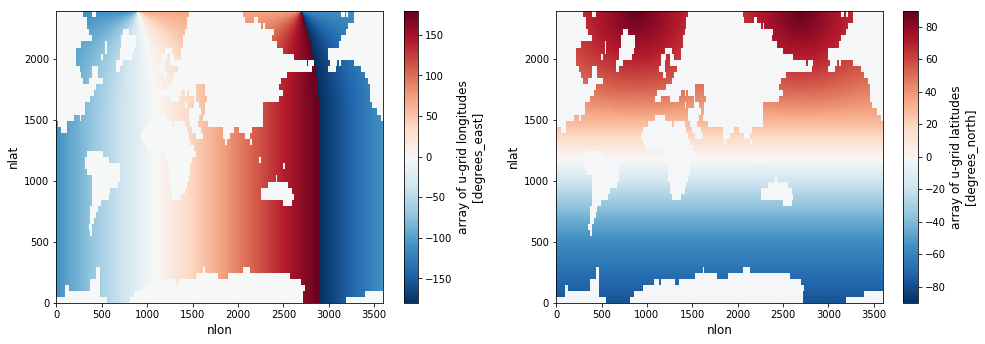

In [190]:
plt.subplot(121)
ds_snap.XU.plot()
plt.subplot(122)
ds_snap.YU.plot()
plt.tight_layout()

In [187]:
XU = ds_snap.XU.values[200:1000,:]
YU = ds_snap.YU.values[200:1000,:]

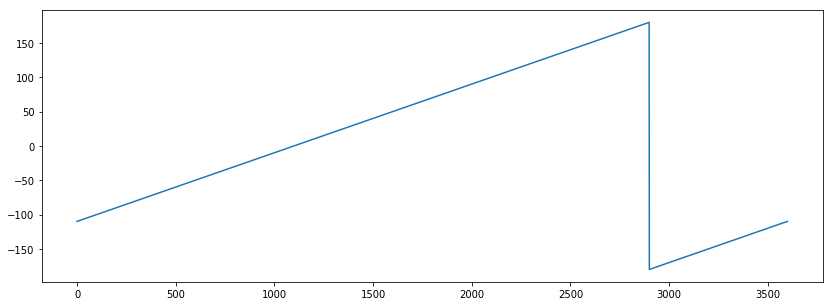

In [189]:
plt.plot(XU[200]);

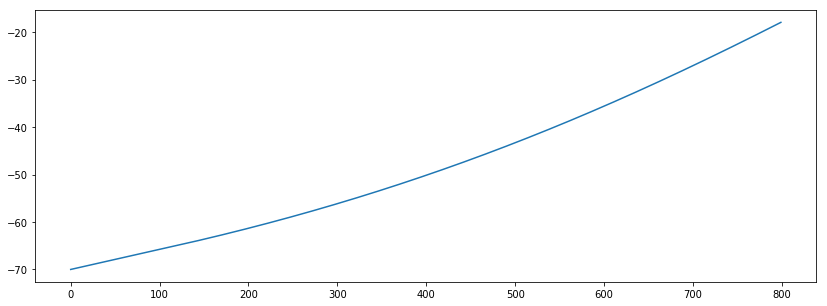

In [196]:
plt.plot(YU[:,200]);

In [206]:
x,y = np.meshgrid(np.roll(XU[200], 700),YU[:,200])

In [200]:
u_ge[200:1000,:].shape

(800, 3600)

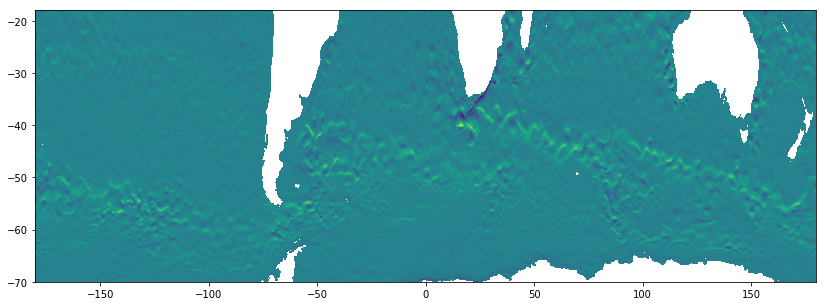

In [208]:
plt.pcolormesh(x,y,np.roll(u_ge[200:1000,:], 700, axis=1))

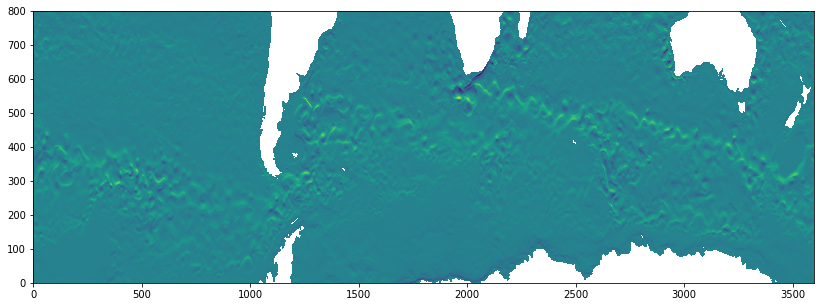

In [205]:
plt.pcolormesh(np.roll(u_ge[200:1000,:], 700, axis=1))

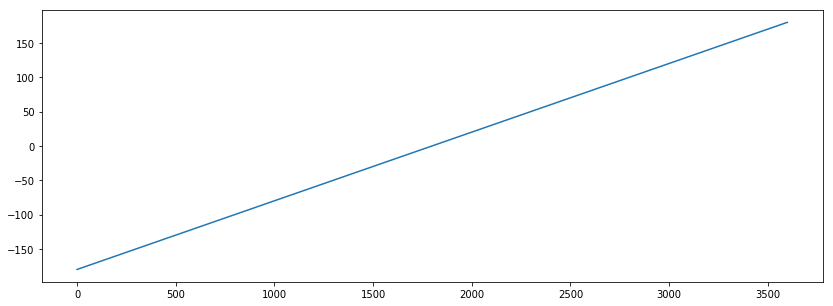

In [195]:
XUrolled = np.roll(XU[200], 700)
plt.plot(XUrolled);

MemoryError: 

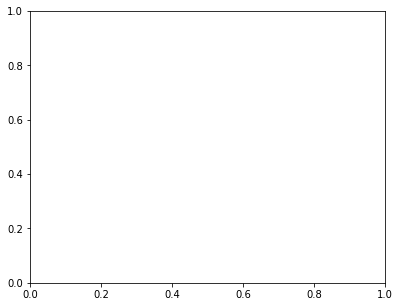

In [143]:
plt.subplot(121)
plt.pcolormesh(lon)
plt.subplot(122)
plt.pcolormesh(lat)


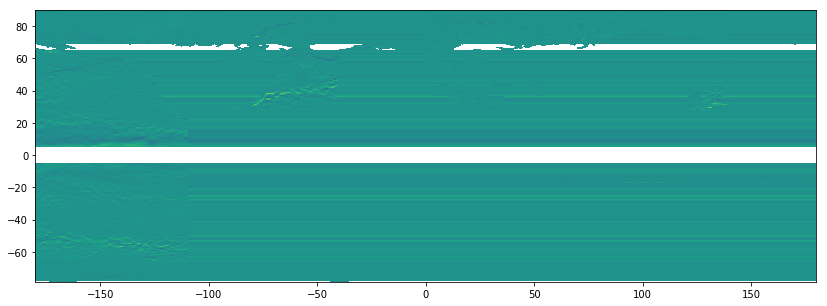

In [131]:
plt.pcolormesh(XU,YU, u_ge)

In [97]:
def ekman_vel(ds):
    rho_a = 1.25
    rho_w = 1027
    C_D = 2.6e-3
    om = 7.2921e-5
    f = 2 * om * np.sin(np.deg2rad(ds.YU.values))
    Az = 1.0e-1  
    f_NH = np.ma.masked_array(f, ~(f>0))
    f_SH = np.ma.masked_array(f, ~(f<0))

    tau_x = ds.TAUX.values
    tau_y = ds.TAUY.values
    
    u_e_N = (tau_x+tau_y)/(np.sqrt(2*Az*rho_w**2) * np.sqrt(np.abs(f_NH)))
    v_e_N = (-tau_x+tau_y)/(np.sqrt(2*Az*rho_w**2) * np.sqrt(np.abs(f_NH))) 
    
    u_e_S = (tau_x-tau_y)/(np.sqrt(2*Az*rho_w**2) * np.sqrt(np.abs(f_SH)))
    v_e_S = (tau_x+tau_y)/(np.sqrt(2*Az*rho_w**2) * np.sqrt(np.abs(f_SH)))
    
    u_e = np.ma.array(u_e_N.filled(0)+u_e_S.filled(0), mask=u_e_N.mask * u_e_S.mask)
    v_e = np.ma.array(v_e_N.filled(0)+v_e_S.filled(0), mask=v_e_N.mask * v_e_S.mask)
    
    return u_e, v_e 

In [103]:
u_e, v_e = ekman_vel(ds_snap)

In [104]:
u_ek = np.ma.masked_array(u_e, ~mask_geo)
v_ek = np.ma.masked_array(v_e, ~mask_geo)


In [105]:
u_ge = u_geo+ u_ek

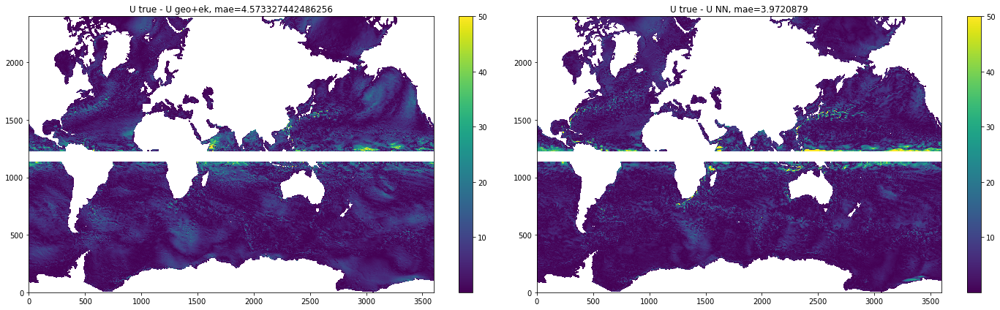

In [110]:
fig = plt.figure(figsize=(20,6))
plt.subplot(121)
plt.pcolormesh(np.abs(u_tr-u_ge), vmax=50, cmap='viridis');
plt.title('U true - U geo+ek, mae=%s' %np.nanmean(np.abs(u_tr-u_ge)))
plt.colorbar()

plt.subplot(122)
plt.pcolormesh(np.abs(u_tr-u_N), vmax=50, cmap='viridis');
plt.title('U true - U NN, mae=%s' %np.nanmean(np.abs(u_tr-u_N)))
plt.colorbar()

plt.tight_layout()


In [109]:
MAE_g = np.nanmean(np.abs(u_tr-u_geo))
MAE_ge= np.nanmean(np.abs(u_tr-u_ge))
MAE_NN = np.nanmean(np.abs(u_tr-u_N))
bias_g = np.nanmean(np.abs(u_tr)) - np.nanmean(np.abs(u_geo))
bias_ge = np.nanmean(np.abs(u_tr)) - np.nanmean(np.abs(u_ge))
bias_NN = np.nanmean(np.abs(u_tr)) - np.nanmean(np.abs(u_N))
print('Bias geo=',bias_g,'Bias geo+ek=',bias_ge,'Bias NN=', bias_NN)

Bias geo= 1.7282153446191515 Bias geo+ek= 1.6605688703982242 Bias NN= 0.31364346


In [116]:
plt.rcParams.update({'font.size': 14
    , 'legend.markerscale': 1., 'axes.titlesize': 14, 'axes.labelsize' : 12,
      'legend.fontsize' : 13,'legend.handlelength': 3})

plt.rc('xtick', labelsize=10) 
plt.rc('ytick', labelsize=10)

lw=2
aph=.2

plt.rcParams['figure.figsize'] = (14.,5.)

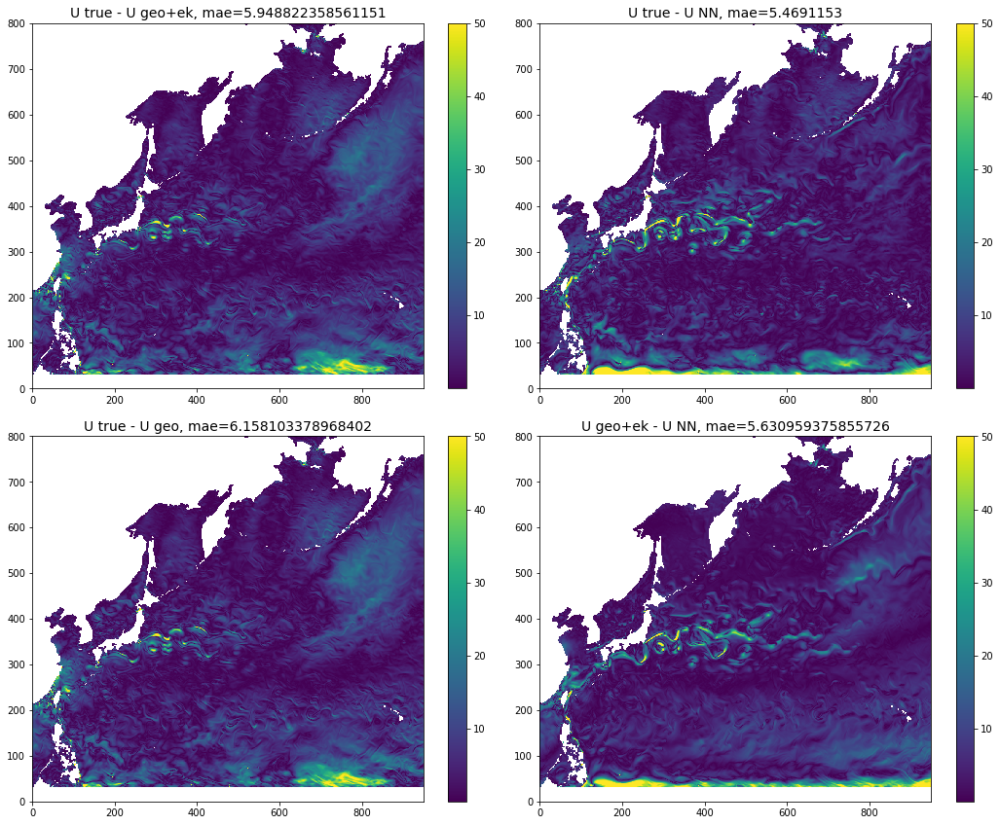

In [117]:
fig = plt.figure(figsize=(15,12))
plt.subplot(221)
plt.pcolormesh(np.abs(u_tr-u_ge)[1200:2000,2250:3200], vmax=50, cmap='viridis');
plt.title('U true - U geo+ek, mae=%s' %np.nanmean(np.abs(u_tr-u_ge)[1200:2000,2250:3200]))
plt.colorbar()

plt.subplot(222)
plt.pcolormesh(np.abs(u_tr-u_N)[1200:2000,2250:3200], vmax=50, cmap='viridis');
plt.title('U true - U NN, mae=%s' %np.nanmean(np.abs(u_tr-u_N)[1200:2000,2250:3200]))
plt.colorbar()

plt.subplot(223)
plt.pcolormesh(np.abs(u_tr-u_geo)[1200:2000,2250:3200], vmax=50, cmap='viridis');
plt.title('U true - U geo, mae=%s' %np.nanmean(np.abs(u_tr-u_geo)[1200:2000,2250:3200]))
plt.colorbar()

plt.subplot(224)
plt.pcolormesh(np.abs(u_ge-u_N)[1200:2000,2250:3200], vmax=50, cmap='viridis');
plt.title('U geo+ek - U NN, mae=%s' %np.nanmean(np.abs(u_ge-u_N)[1200:2000,2250:3200]))
plt.colorbar()

plt.tight_layout()


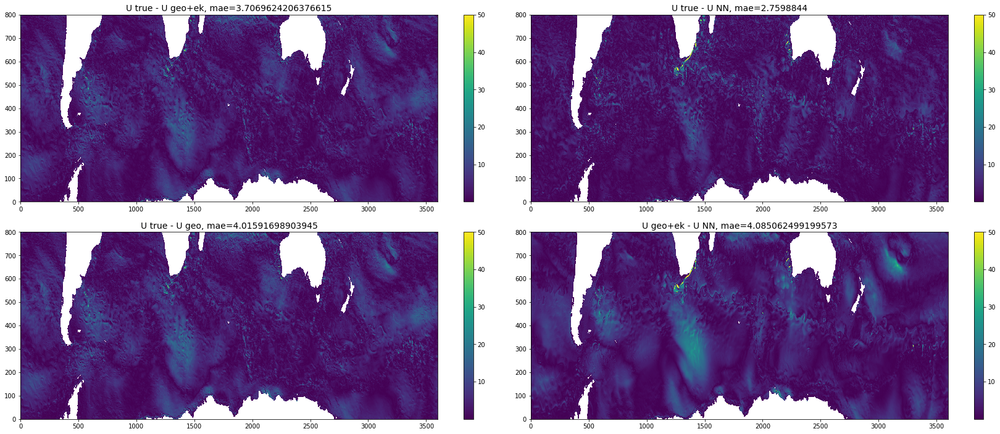

In [120]:
fig = plt.figure(figsize=(24,10))
plt.subplot(221)
plt.pcolormesh(np.abs(u_tr-u_ge)[200:1000,:], vmax=50, cmap='viridis');
plt.title('U true - U geo+ek, mae=%s' %np.nanmean(np.abs(u_tr-u_ge)[200:1000,:]))
plt.colorbar()

plt.subplot(222)
plt.pcolormesh(np.abs(u_tr-u_N)[200:1000,:], vmax=50, cmap='viridis');
plt.title('U true - U NN, mae=%s' %np.nanmean(np.abs(u_tr-u_N)[200:1000,:]))
plt.colorbar()

plt.subplot(223)
plt.pcolormesh(np.abs(u_tr-u_geo)[200:1000,:], vmax=50, cmap='viridis');
plt.title('U true - U geo, mae=%s' %np.nanmean(np.abs(u_tr-u_geo)[200:1000,:]))
plt.colorbar()

plt.subplot(224)
plt.pcolormesh(np.abs(u_ge-u_N)[200:1000,:], vmax=50, cmap='viridis');
plt.title('U geo+ek - U NN, mae=%s' %np.nanmean(np.abs(u_ge-u_N)[200:1000,:]))
plt.colorbar()

plt.tight_layout()


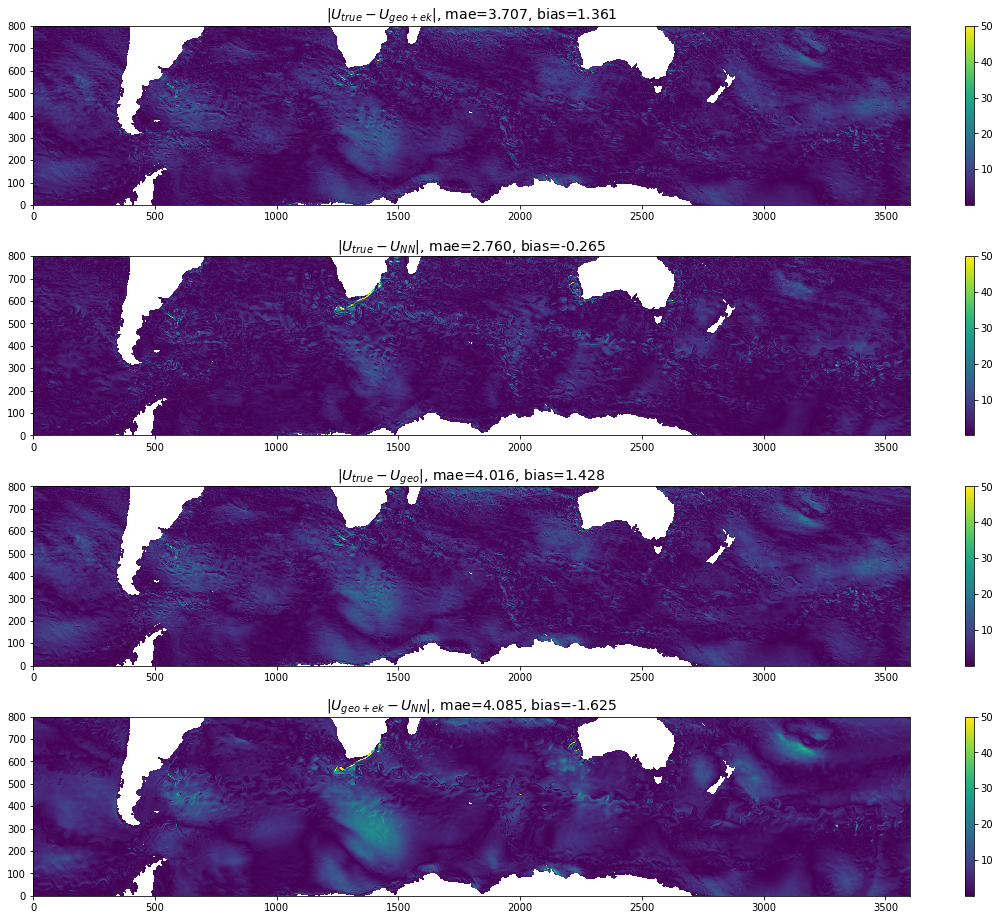

In [128]:
fig = plt.figure(figsize=(16,13))
plt.subplot(411)
plt.pcolormesh(np.abs(u_tr-u_ge)[200:1000,:], vmax=50, cmap='viridis');
plt.title(r'$\|U_{true} - U_{geo+ek}\|$, mae=%1.3f, bias=%1.3f' 
          %(np.nanmean(np.abs(u_tr-u_ge)[200:1000,:]), np.nanmean(np.abs(u_tr[200:1000,:])) - np.nanmean(np.abs(u_ge[200:1000,:])) ))
plt.colorbar()

plt.subplot(412)
plt.pcolormesh(np.abs(u_tr-u_N)[200:1000,:], vmax=50, cmap='viridis');
plt.title(r'$\|U_{true} - U_{NN}\|$, mae=%1.3f, bias=%1.3f' 
          %(np.nanmean(np.abs(u_tr-u_N)[200:1000,:]), np.nanmean(np.abs(u_tr[200:1000,:])) - np.nanmean(np.abs(u_N[200:1000,:])) ))
plt.colorbar()

plt.subplot(413)
plt.pcolormesh(np.abs(u_tr-u_geo)[200:1000,:], vmax=50, cmap='viridis');
plt.title(r'$\|U_{true} - U_{geo}\|$, mae=%1.3f, bias=%1.3f' 
          %(np.nanmean(np.abs(u_tr-u_geo)[200:1000,:]), np.nanmean(np.abs(u_tr[200:1000,:])) - np.nanmean(np.abs(u_geo[200:1000,:])) ))
plt.colorbar()

plt.subplot(414)
plt.pcolormesh(np.abs(u_ge-u_N)[200:1000,:], vmax=50, cmap='viridis');
plt.title(r'$\|U_{geo+ek} - U_{NN}\|$, mae=%1.3f, bias=%1.3f' 
          %(np.nanmean(np.abs(u_ge-u_N)[200:1000,:]), np.nanmean(np.abs(u_ge[200:1000,:])) - np.nanmean(np.abs(u_N[200:1000,:])) ))
plt.colorbar()

plt.tight_layout()


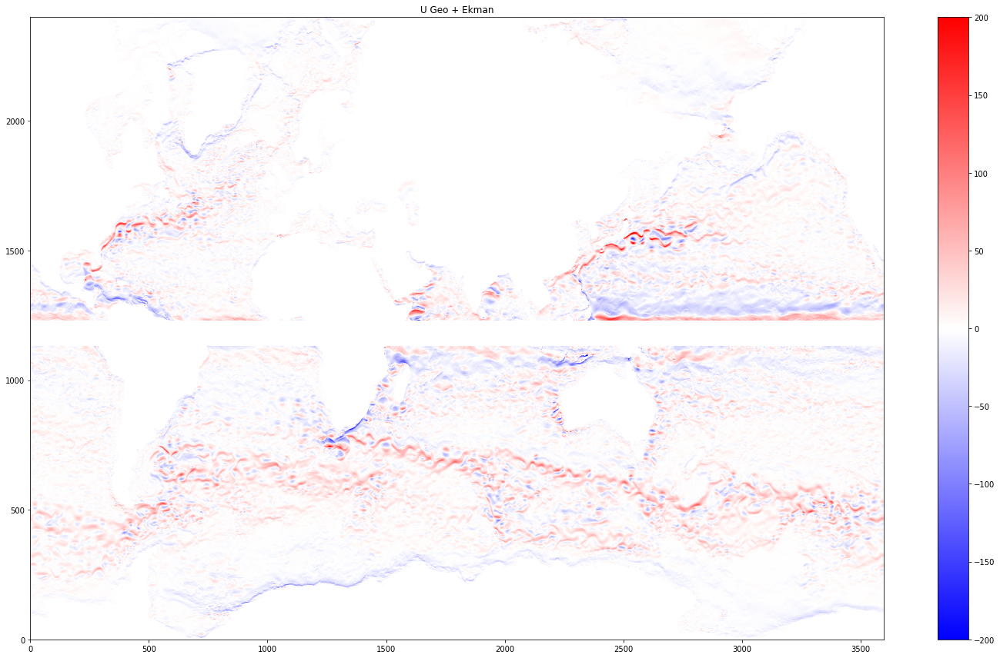

In [108]:
fig = plt.figure(figsize=(20,12))
plt.pcolormesh(u_ge, vmax=200,vmin=-200, cmap='bwr');
plt.title('U Geo + Ekman')
plt.colorbar()
plt.tight_layout()

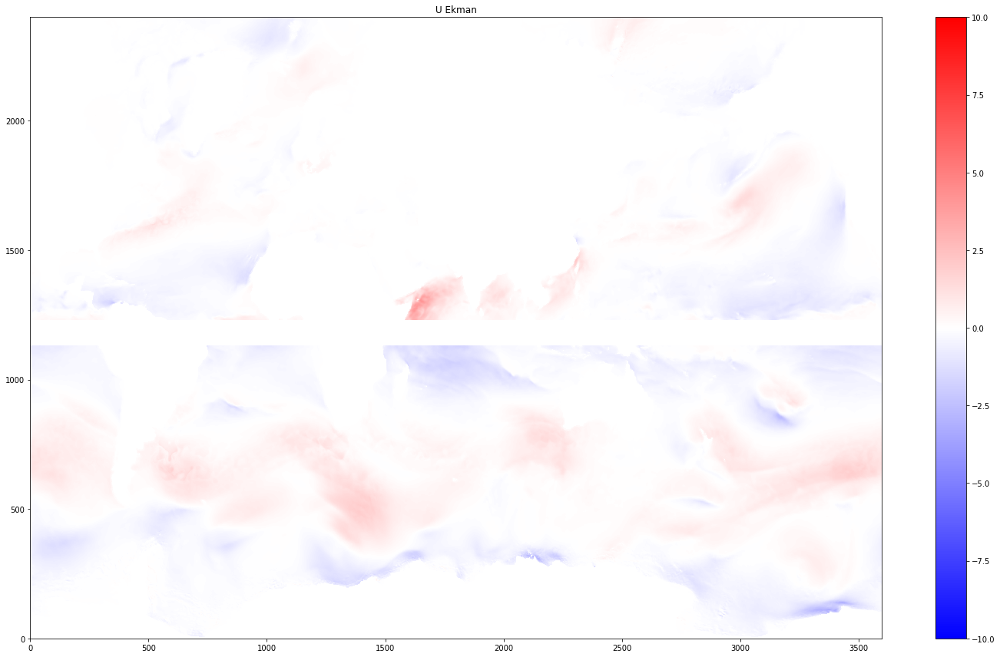

In [106]:
fig = plt.figure(figsize=(20,12))
plt.pcolormesh(u_ek, vmax=10,vmin=-10, cmap='bwr');
plt.title('U Ekman')
plt.colorbar()
plt.tight_layout()

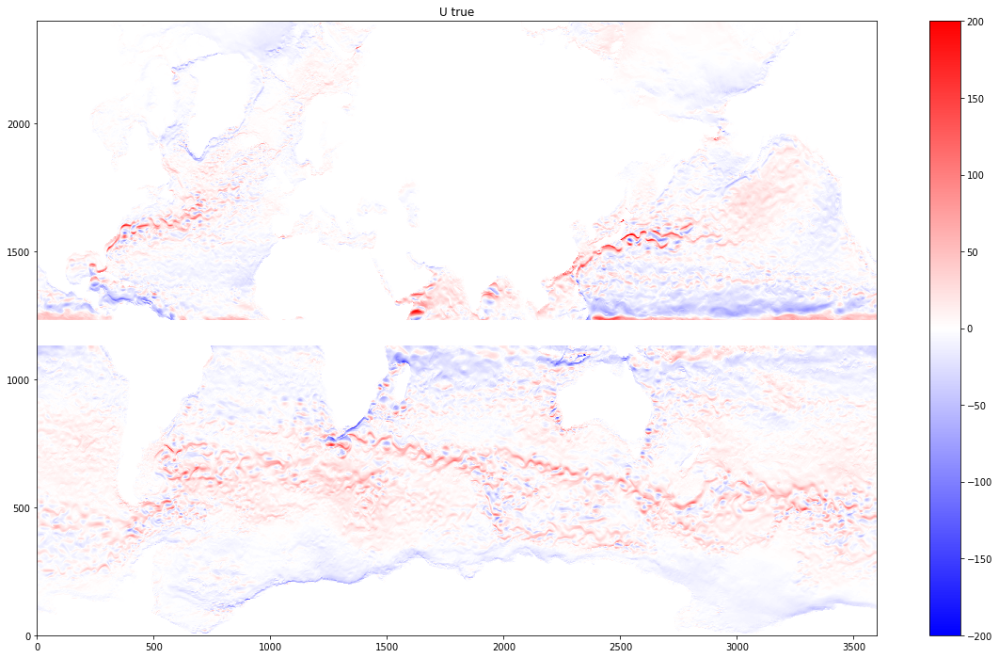

In [70]:
fig = plt.figure(figsize=(20,12))
u_tr= np.ma.masked_array(u_true, ~mask_geo)
plt.pcolormesh(u_tr, vmax=200, vmin=-200, cmap='bwr');
plt.title('U true')
plt.colorbar()

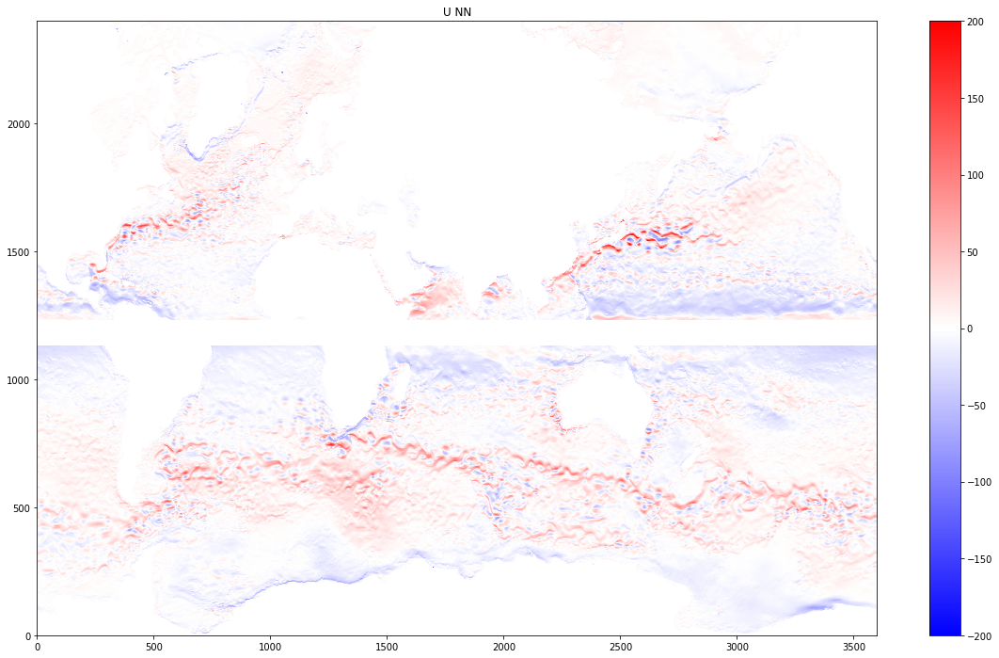

In [71]:
fig = plt.figure(figsize=(20,12))
u_N = np.ma.masked_array(u_nn, ~mask_geo)
plt.pcolormesh(u_N, vmax=200, vmin=-200, cmap='bwr');
plt.title('U NN')
plt.colorbar()

In [2]:
fig = plt.figure(figsize=(20,6))
plt.subplot(121)
plt.pcolormesh(np.abs(u_tr-u_geo), vmax=200, cmap='viridis');
plt.title('U true - U geo, mae=%s' %np.nanmean(np.abs(u_tr-u_geo)))
plt.colorbar()

plt.subplot(122)
plt.pcolormesh(np.abs(u_tr-u_N), vmax=200, cmap='viridis');
plt.title('U true - U NN, mae=%s' %np.nanmean(np.abs(u_tr-u_N)))
plt.colorbar()



NameError: name 'plt' is not defined

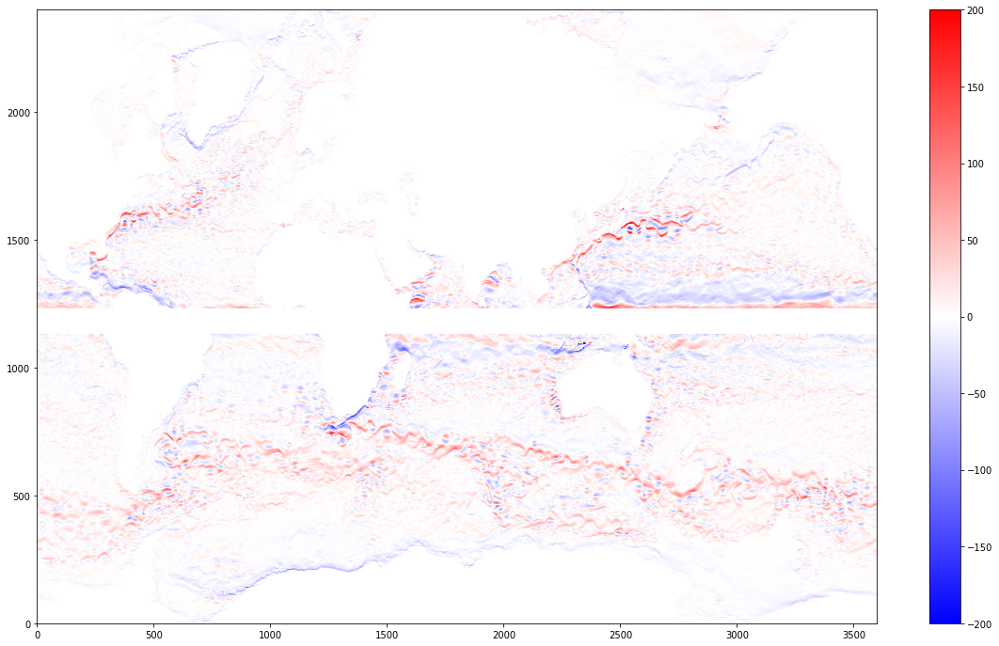

In [69]:
fig = plt.figure(figsize=(20,12))
u_geo = np.ma.masked_array(u_g, ~mask_geo)
plt.pcolormesh(u_geo, vmax=200, vmin=-200, cmap='bwr');
plt.colorbar()

In [63]:
mask_geo

array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

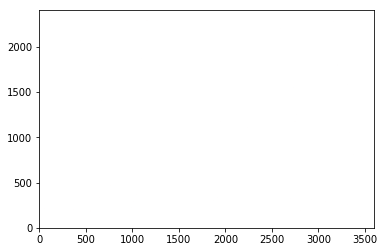

In [51]:
plt.pcolormesh(np.ma.masked_where(u_g, ~mask_geo), vmax=200, vmin=-200, cmap='bwr')


In [48]:

fig = plt.figure(figsize=(20,12))
plt.pcolormesh(np.ma.masked_invalid(u_g, mask_geo), vmax=200, vmin=-200, cmap='bwr')
plt.title('geostrophic U', fontsize=16)
plt.colorbar()
plt.tight_layout()


ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

<Figure size 1440x864 with 0 Axes>

In [21]:
XU = ds_snap.XU.values
YU = ds_snap.YU.values

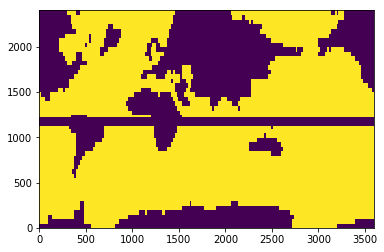

In [41]:
mask_lat = ((ds_snap.YU.values>5)|(ds_snap.YU.values<-5))
plt.pcolormesh(mask_lat)

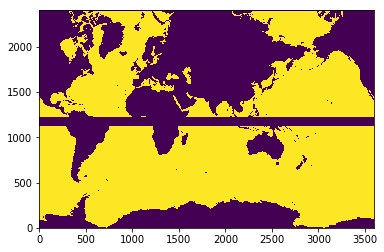

In [45]:
mask_geo = (mask_tot&mask_lat)
plt.pcolormesh(mask_geo)

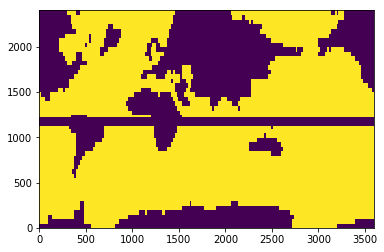

In [39]:
mask_lat_val = mask_lat.values
plt.pcolormesh(mask_lat_val)

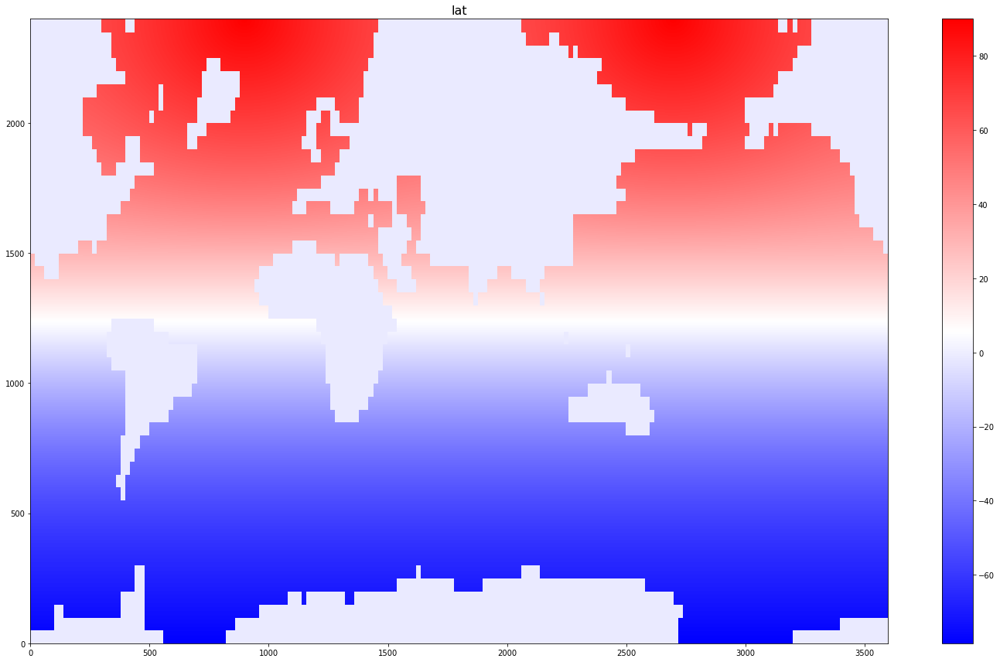

In [32]:
fig = plt.figure(figsize=(20,12))
plt.pcolormesh(YU, cmap='bwr', rasterized=True);
plt.title('lat', fontsize=16)
plt.colorbar()
plt.tight_layout()

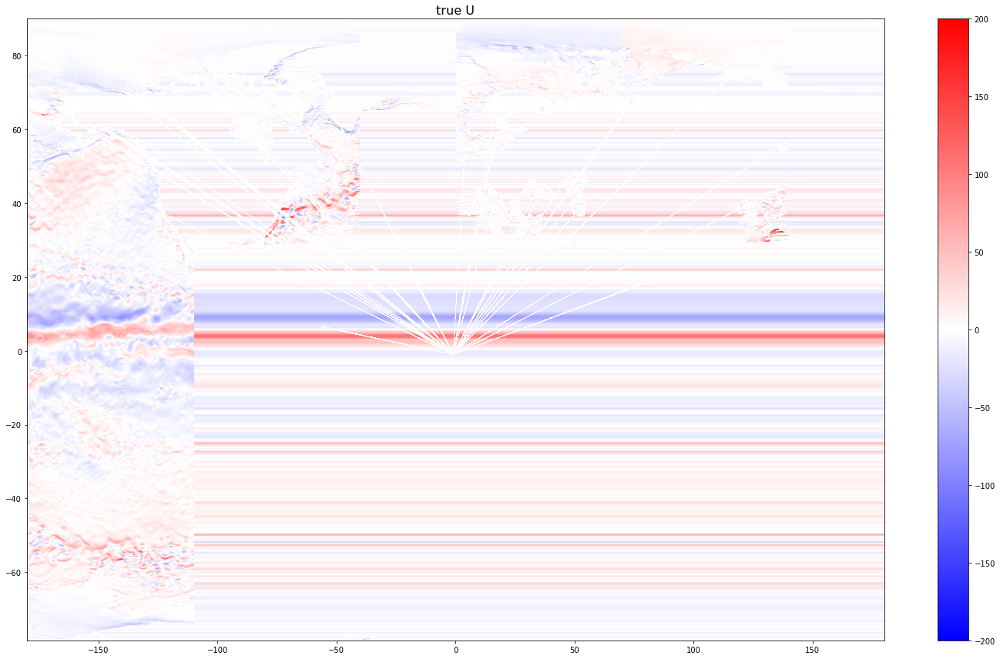

In [22]:
fig = plt.figure(figsize=(20,12))
plt.pcolormesh(XU,YU,u_true, vmax=200, vmin=-200, cmap='bwr', rasterized=True);
plt.title('true U', fontsize=16)
plt.colorbar()
plt.tight_layout()

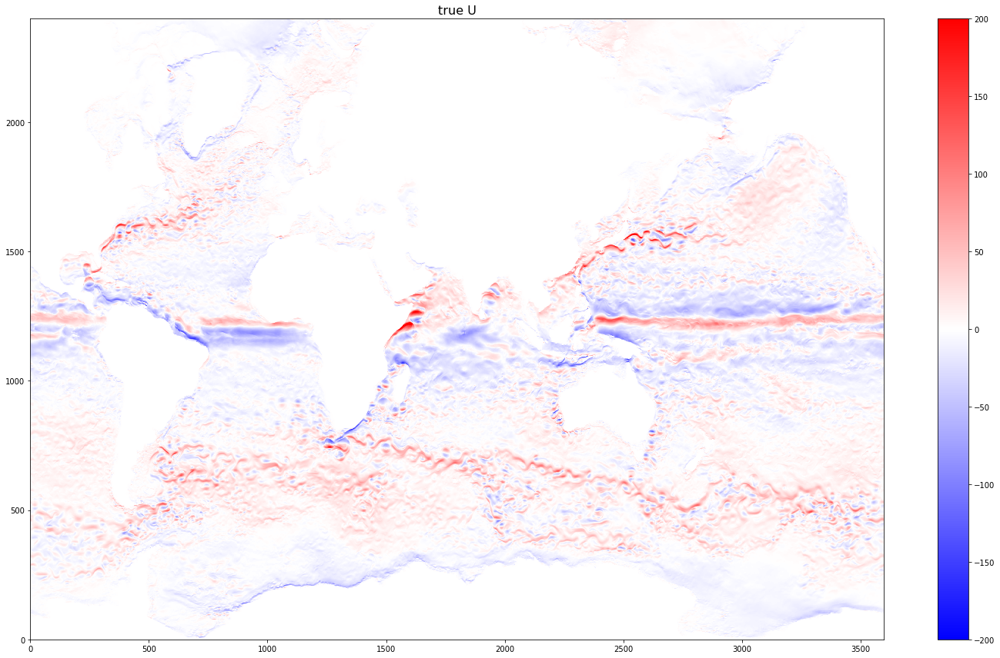

In [20]:
fig = plt.figure(figsize=(20,12))
plt.pcolormesh(u_true, vmax=200, vmin=-200, cmap='bwr', rasterized=True);
plt.title('true U', fontsize=16)
plt.colorbar()
plt.tight_layout()

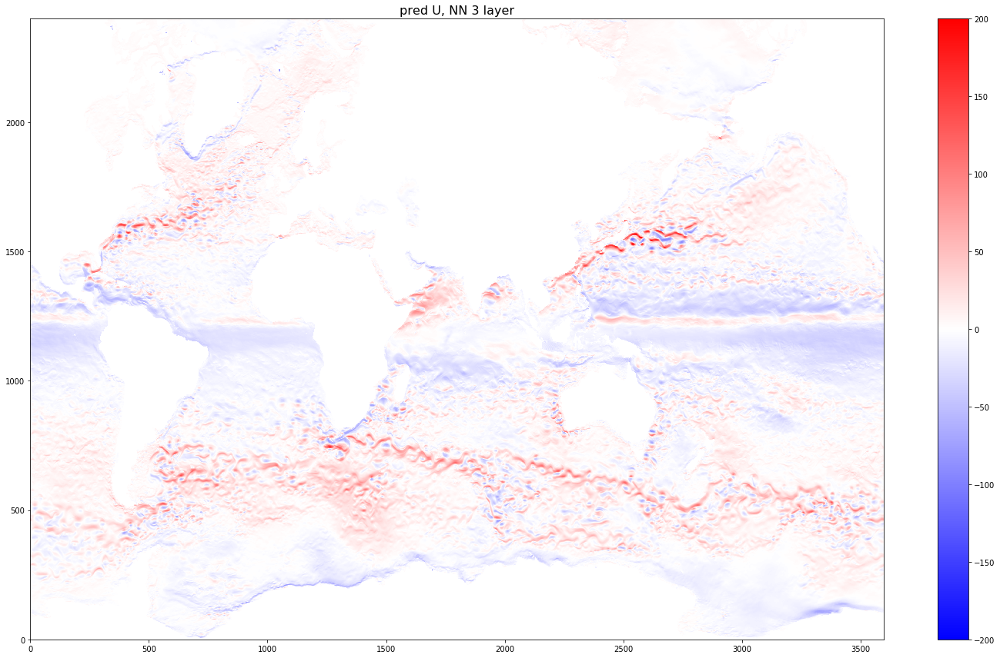

In [21]:
fig = plt.figure(figsize=(20,12))
plt.pcolormesh(u_nn, vmax=200, vmin=-200, cmap='bwr', rasterized=True);
plt.title('pred U, NN 3 layer', fontsize=16)
plt.colorbar()
plt.tight_layout()

In [1]:
from mpl_toolkits.basemap import Basemap


KeyError: 'PROJ_LIB'

In [1]:
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline  
import warnings
import matplotlib.cbook
warnings.filterwarnings("ignore",category=matplotlib.cbook.mplDeprecation)

KeyError: 'PROJ_LIB'

In [25]:
#Hack to fix missing PROJ4 env var
import os
import conda

conda_file_dir = conda.__file__
conda_dir = conda_file_dir.split('lib')[0]
proj_lib = os.path.join(os.path.join(conda_dir, 'share'), 'proj')
os.environ["PROJ_LIB"] = proj_lib

from mpl_toolkits.basemap import Basemap

ModuleNotFoundError: No module named 'conda'

In [9]:
import keras
from keras.utils.vis_utils import model_to_dot
from keras.utils.vis_utils import plot_model
feature_cols = ['X', 'Y', 'Z',
                'X_e','X_w','X_n','X_s','X_ne','X_se','X_nw','X_sw',
                'Y_e','Y_w','Y_n','Y_s','Y_ne','Y_se','Y_nw','Y_sw',
                'Z_e','Z_w','Z_n','Z_s','Z_ne','Z_se','Z_nw','Z_sw',
                'TAUX','TAUY','SST','SSH',
                'SSH_e','SSH_w','SSH_n','SSH_s','SSH_ne','SSH_se','SSH_nw','SSH_sw']
model = keras.Sequential([
    keras.layers.Dense(40, activation=tf.nn.relu,
                       input_shape=(len(feature_cols),),
                       name='hidden_layer_1',),
    keras.layers.Dense(20, activation=tf.nn.relu, 
                       name='hidden_layer_2'),
    keras.layers.Dense(10, activation=tf.nn.relu, 
                       name='hidden_layer_3'),
    keras.layers.Dense(2, name='output_layer',)
])

# Define your optimizer asdf
#optimizer = tf.train.AdamOptimizer()
model.compile(loss='mse',
            optimizer='adam',
            metrics=['mae', 'mse','accuracy'])

# show a summary of the data
model.summary()

Instructions for updating:
keep_dims is deprecated, use keepdims instead
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
hidden_layer_1 (Dense)       (None, 40)                1600      
_________________________________________________________________
hidden_layer_2 (Dense)       (None, 20)                820       
_________________________________________________________________
hidden_layer_3 (Dense)       (None, 10)                210       
_________________________________________________________________
output_layer (Dense)         (None, 2)                 22        
Total params: 2,652
Trainable params: 2,652
Non-trainable params: 0
_________________________________________________________________


In [14]:
plot_model(model, to_file='Figs_regression/model_plot3.png', show_shapes=True, show_layer_names=False)


In [10]:
plot_model(model, to_file='Figs_regression/model_plot.png', show_shapes=True, show_layer_names=True)


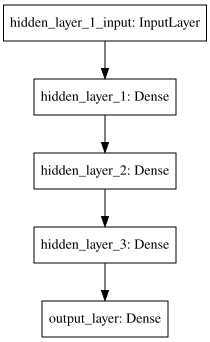

In [12]:
SVG(model_to_dot(model).create(prog='dot', format='svg'))


In [13]:
model = keras.Sequential()
model.add(keras.layers.Dense(2, input_dim=1, activation='relu'))
model.add(keras.layers.Dense(1, activation='sigmoid'))
plot_model(model, to_file='test.png', show_shapes=True, show_layer_names=True)

AttributeError: 'Sequential' object has no attribute 'container_nodes'